<a href="https://colab.research.google.com/github/HLCV-23/Inpainting-Detection/blob/Nicola/creative_inpainting.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install transformers
!pip install diffusers
!pip install accelerate
!pip install xformers
import numpy as np
from diffusers import StableDiffusionInpaintPipeline
from transformers import pipeline
from transformers import AutoModelForCausalLM, AutoTokenizer
import torch
import pandas as pd
import time
import os

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
device = torch.device("cuda:0")

mask_generator = pipeline("mask-generation", model="facebook/sam-vit-huge", device=device)

#caption_generator = pipeline("image-to-text", model="nlpconnect/vit-gpt2-image-captioning")
caption_generator = pipeline("image-to-text", model="Salesforce/blip-image-captioning-base")  # Is BLIP fast enough?

tokenizer = AutoTokenizer.from_pretrained("Gustavosta/MagicPrompt-Stable-Diffusion")
model = AutoModelForCausalLM.from_pretrained("Gustavosta/MagicPrompt-Stable-Diffusion")
prompt_generator = pipeline("text-generation", model=model, tokenizer = tokenizer, device = device)

inpainting_generator = StableDiffusionInpaintPipeline.from_pretrained(
    "runwayml/stable-diffusion-inpainting",
    torch_dtype=torch.float16,
    safety_checker=None,
    low_cpu_mem_usage = False
).to(device)

text_encoder/model.safetensors not found
You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion_inpaint.StableDiffusionInpaintPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


In [ ]:
from PIL import Image, ImageFilter

def generate_datapoint_single_mask(data, id, path):
    original_img = data
    image_area = 512*512
    masks = mask_generator(original_img)["masks"]

    # Only masks with an area not too large or too small are eligible candidates for inpainting
    valid_masks = [mask for idx, mask in enumerate(masks) if (image_area * 0.1 <= mask.sum() <= image_area * 0.6)]

    if (valid_masks != []):
      choice = np.random.choice(np.arange(len(valid_masks)))
      mask = valid_masks[choice]
    else:
      mask_ids = []
      pixels_covered = 0.
      for i in range(len(masks)):
        mask_ids.append(i)

        area = np.sum(masks[i])

        pixels_covered += area/(512**2)

        if pixels_covered > 0.2 or i == len(masks) - 1:
          break

      # combine these masks into a single mask
      mask = masks[mask_ids[0]]
      for i in range(len(mask_ids)):
        mask_id = mask_ids[i]
        curr_mask = masks[mask_id]
        mask = np.logical_or(mask, curr_mask)

    mask_img = Image.fromarray((mask * 255).astype(np.uint8).squeeze())
    mask_img = mask_img.convert("RGB")
    mask_img.show()

    # Generate prompt for inpainting model
    caption = caption_generator(original_img)[0]["generated_text"]
    prompts = prompt_generator(caption)[0]["generated_text"]
    prompts = prompts.replace(". ", ", ")
    prompts = prompts.split(",")
    try:
      prompt = prompts[0] + prompts[1]
    except:
      prompt = prompts[0]

    print(prompt)

    # inpaint
    inpainted_img = inpainting_generator(prompt=prompt, image=original_img, mask_image=mask_img, height=512, width=512).images[0]

    modified_img = Image.composite(inpainted_img, original_img, mask_img.convert("1")).convert("RGB")
    modified_img.show()

    modified_img.save(path + f"/{id}.png")
    print(f"Saved processed image {id}.png")

    return modified_img

In [ ]:
!mkdir drive/MyDrive/Creative_Test5/

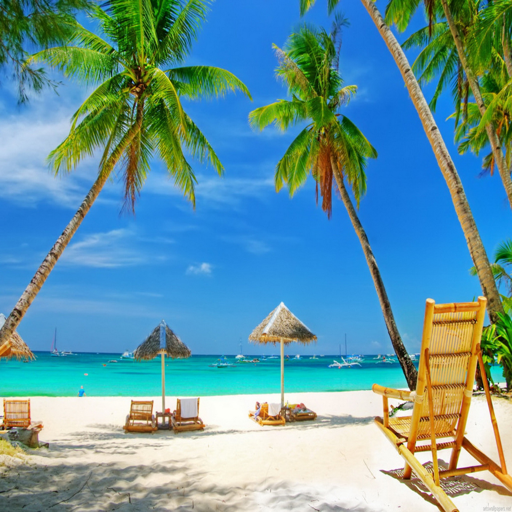

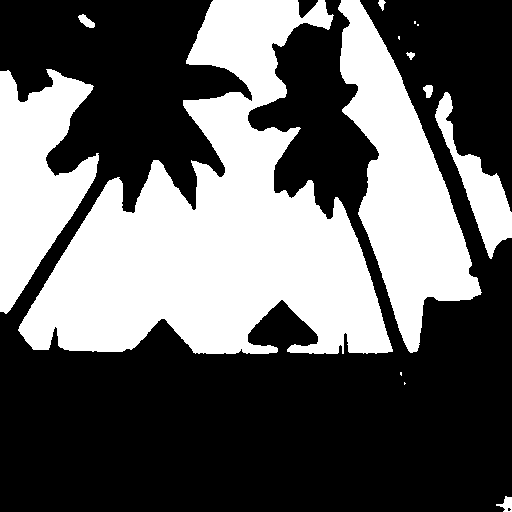

/usr/local/lib/python3.10/dist-packages/transformers/generation/utils.py:1369: UserWarning: Using `max_length`'s default (20) to control the generation length. This behaviour is deprecated and will be removed from the config in v5 of Transformers -- we recommend using `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(
Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.
/usr/local/lib/python3.10/dist-packages/transformers/generation/utils.py:1369: UserWarning: Using `max_length`'s default (50) to control the generation length. This behaviour is deprecated and will be removed from the config in v5 of Transformers -- we recommend using `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(


a beach with palm trees and chairs colorful


  0%|          | 0/50 [00:00<?, ?it/s]

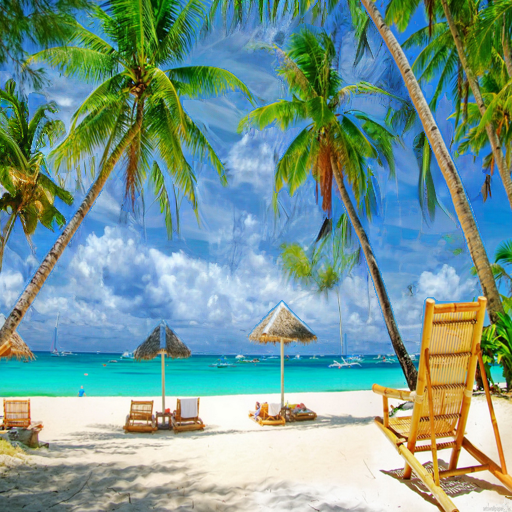

Saved processed image 1.png
Time passed: 22.748796224594116


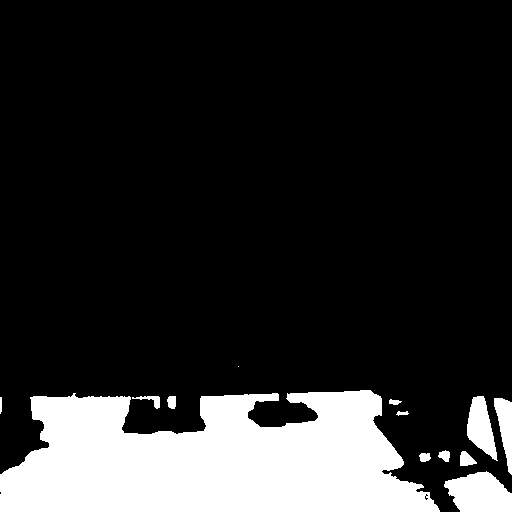

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a beach with palm trees and chairs at sunset sunrise


  0%|          | 0/50 [00:00<?, ?it/s]

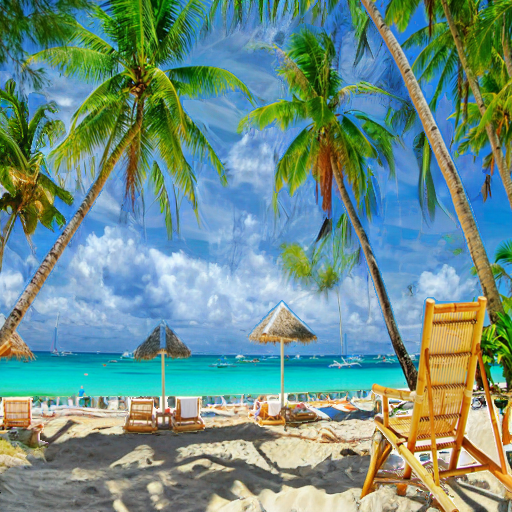

Saved processed image 2.png
Time passed: 39.88542699813843


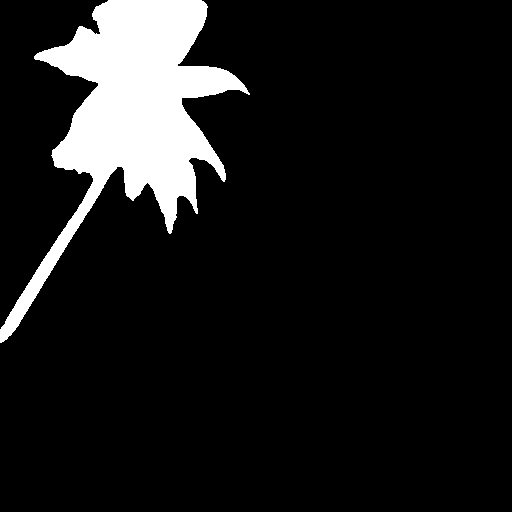

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a beach with palm trees and chairs hyper realistic oil painting


  0%|          | 0/50 [00:00<?, ?it/s]

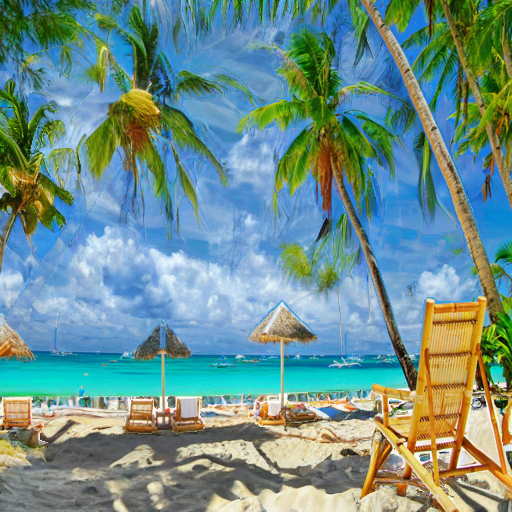

Saved processed image 3.png
Time passed: 57.02246880531311


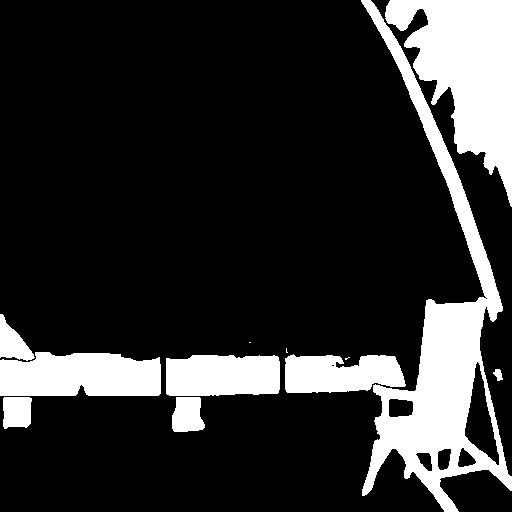

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a beach with palm trees and chairs dynamic lighting


  0%|          | 0/50 [00:00<?, ?it/s]

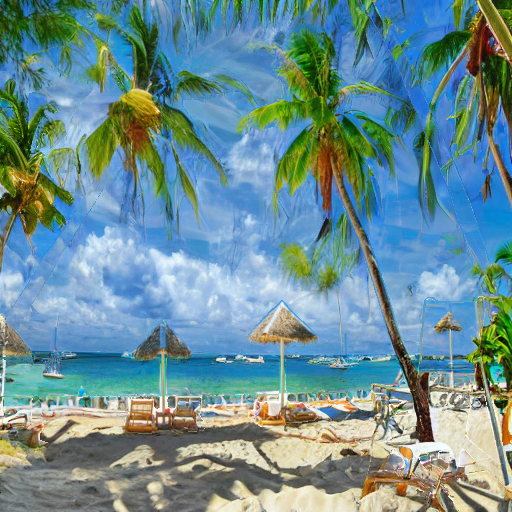

Saved processed image 4.png
Time passed: 74.14007997512817


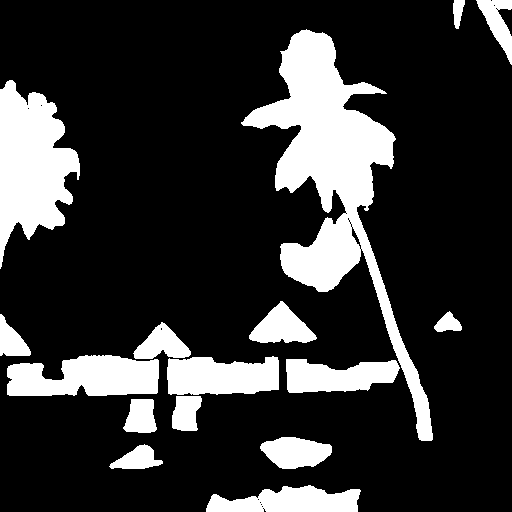

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a beach with palm trees and a boat in the water at sunrise golden hour


  0%|          | 0/50 [00:00<?, ?it/s]

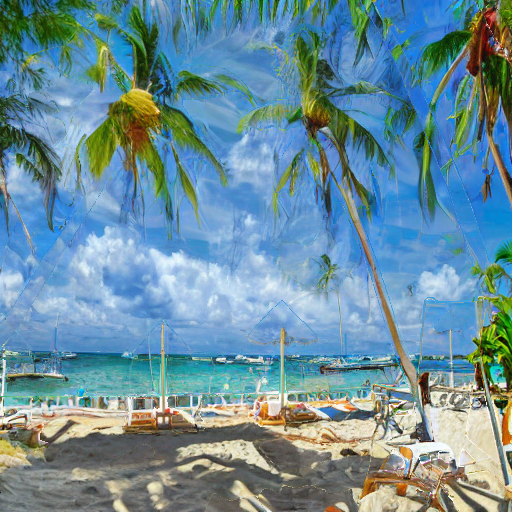

Saved processed image 5.png
Time passed: 94.30870199203491


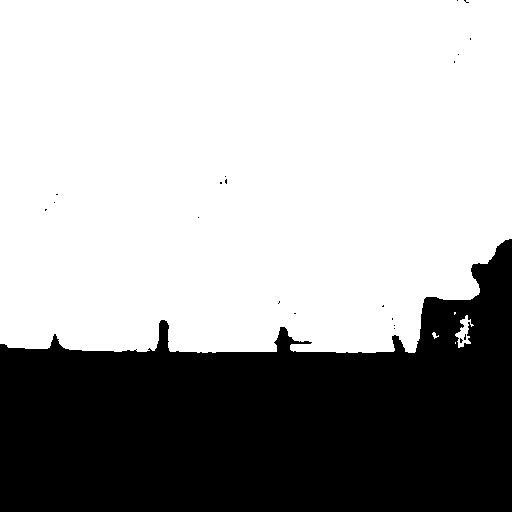

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a beach with palm trees and boats in the water at sunset trending on artstation



  0%|          | 0/50 [00:00<?, ?it/s]

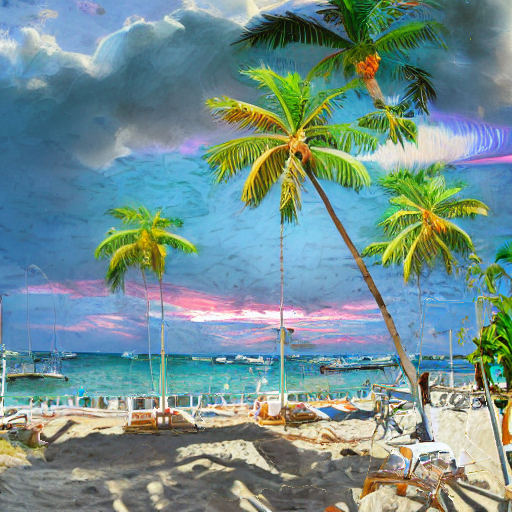

Saved processed image 6.png
Time passed: 112.7807047367096


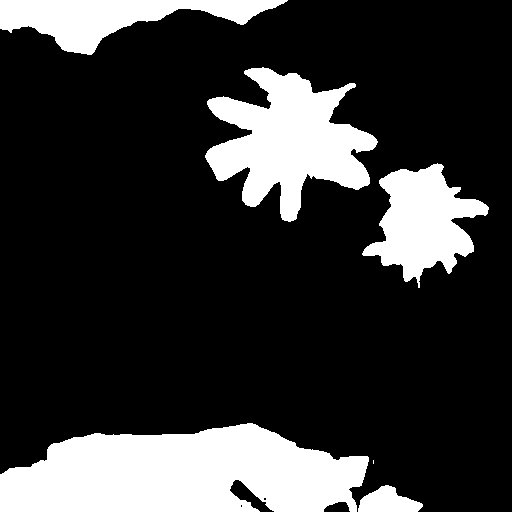

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees and sand at sunrise ski and board boats on the beach


  0%|          | 0/50 [00:00<?, ?it/s]

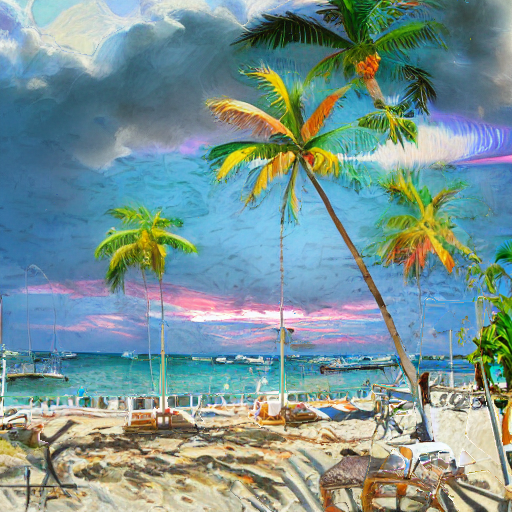

Saved processed image 7.png
Time passed: 130.7027518749237


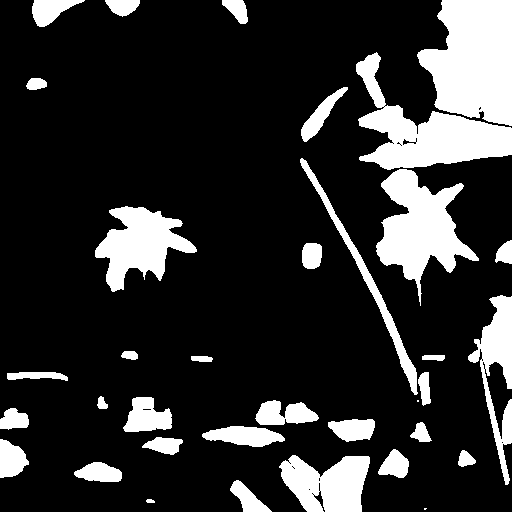

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background near a magical beach with palm trees psychedelic digital art


  0%|          | 0/50 [00:00<?, ?it/s]

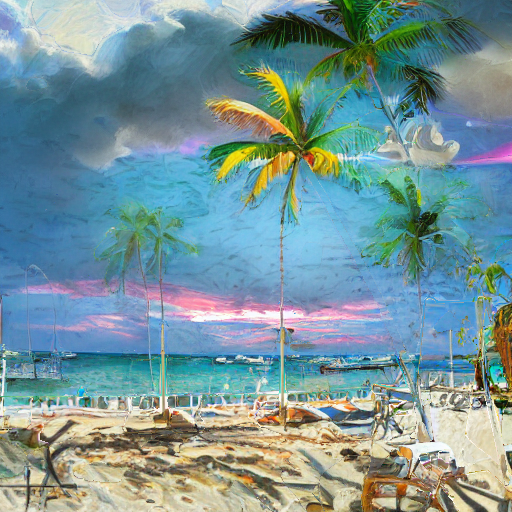

Saved processed image 8.png
Time passed: 148.3695569038391


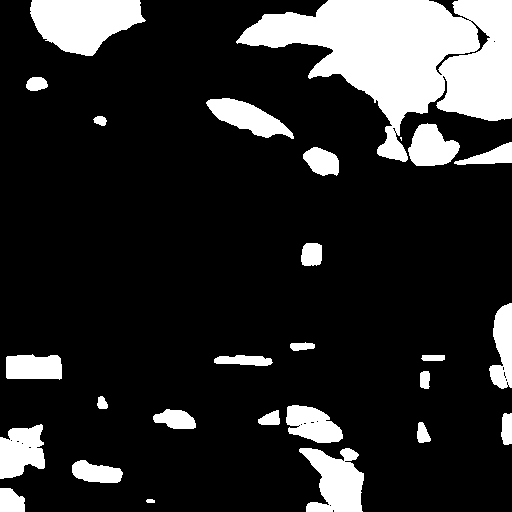

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background hyperrealistic


  0%|          | 0/50 [00:00<?, ?it/s]

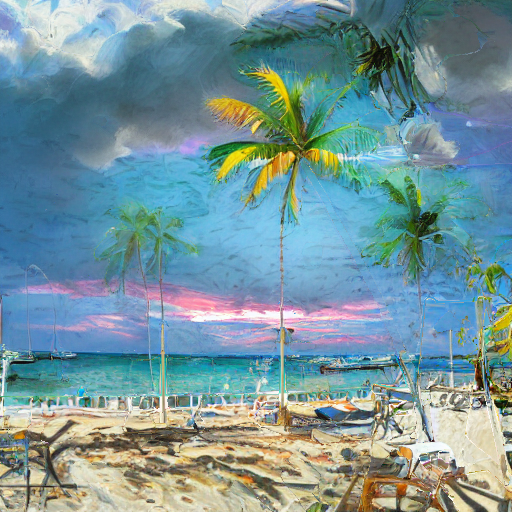

Saved processed image 9.png
Time passed: 166.08088636398315


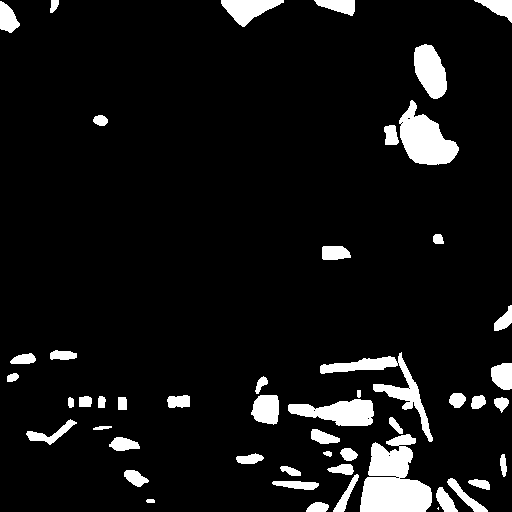

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background natural light


  0%|          | 0/50 [00:00<?, ?it/s]

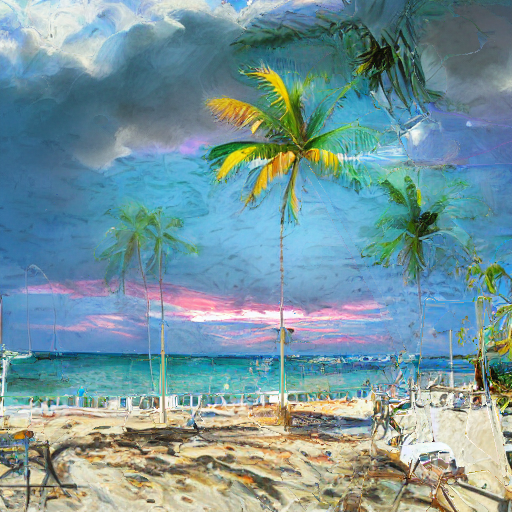

Saved processed image 10.png
Time passed: 184.72593331336975


/usr/local/lib/python3.10/dist-packages/transformers/pipelines/base.py:1083: UserWarning: You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
  warnings.warn(


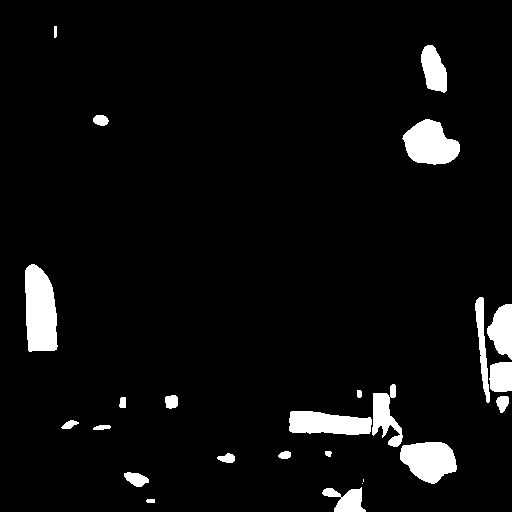

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background vibrant colors


  0%|          | 0/50 [00:00<?, ?it/s]

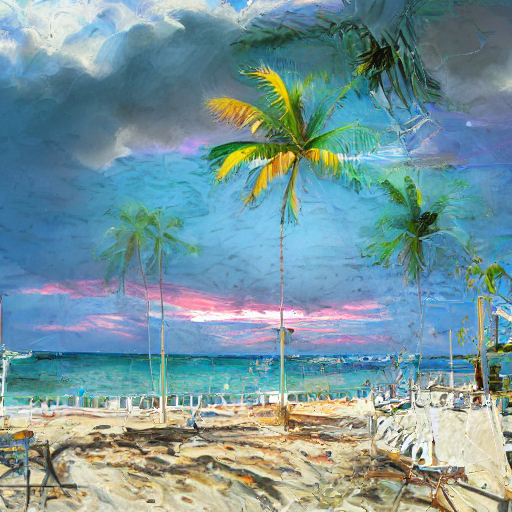

Saved processed image 11.png
Time passed: 203.39838886260986


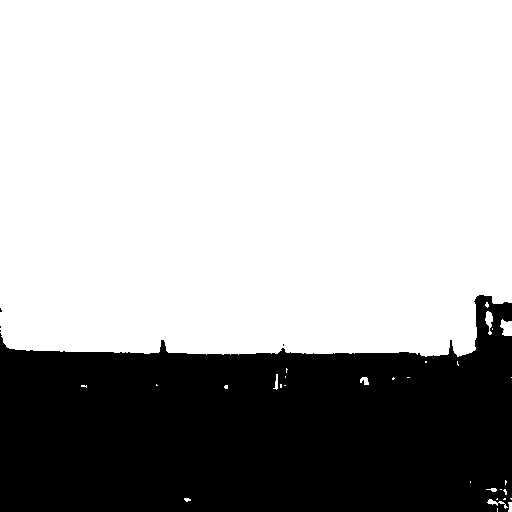

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background trending on artstation



  0%|          | 0/50 [00:00<?, ?it/s]

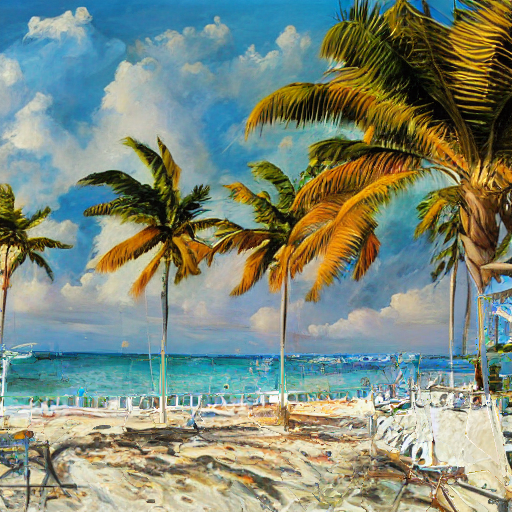

Saved processed image 12.png
Time passed: 220.89965391159058


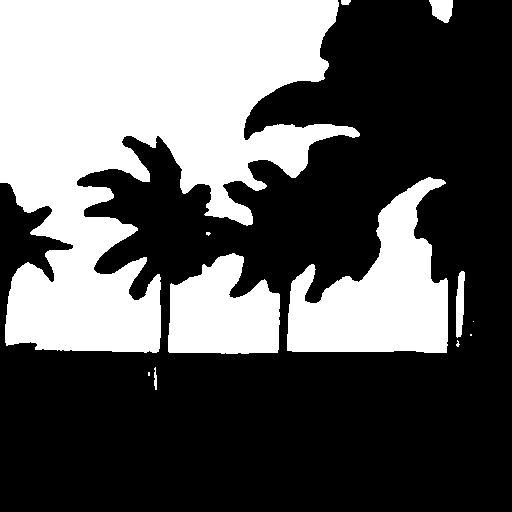

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of palm trees on the beach by jeffrey smith cumberbatch


  0%|          | 0/50 [00:00<?, ?it/s]

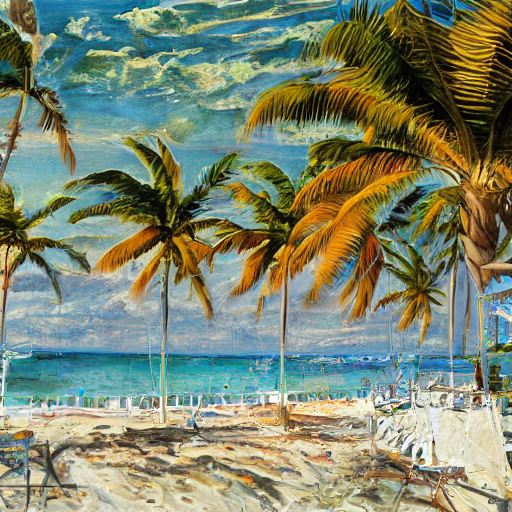

Saved processed image 13.png
Time passed: 239.06243348121643


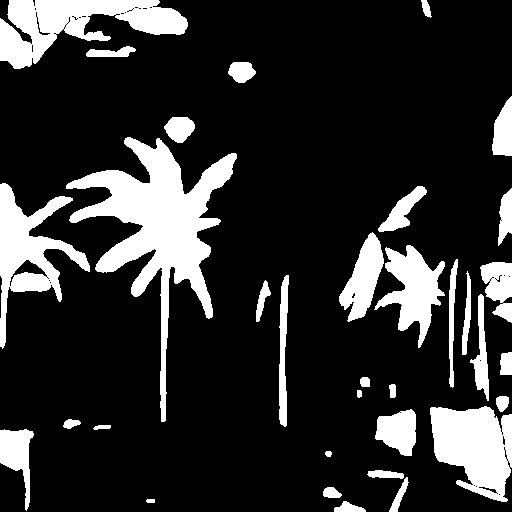

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of palm trees on the beach sunbeams


  0%|          | 0/50 [00:00<?, ?it/s]

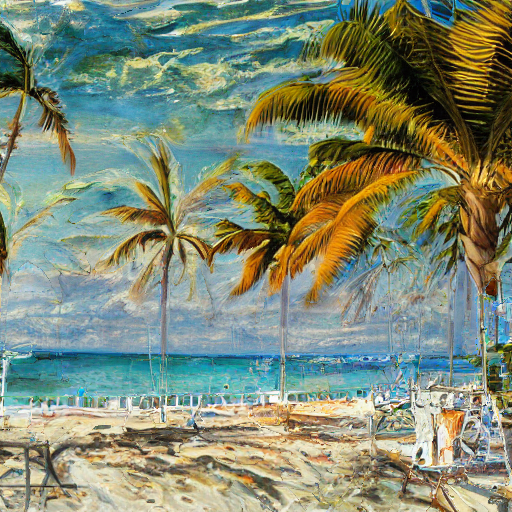

Saved processed image 14.png
Time passed: 256.58593368530273


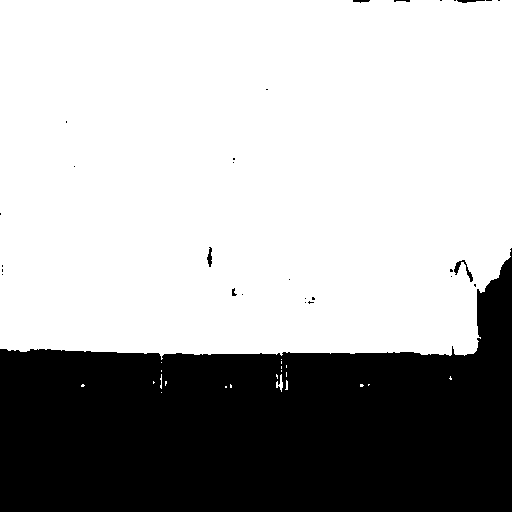

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of palm trees on the beach sunset


  0%|          | 0/50 [00:00<?, ?it/s]

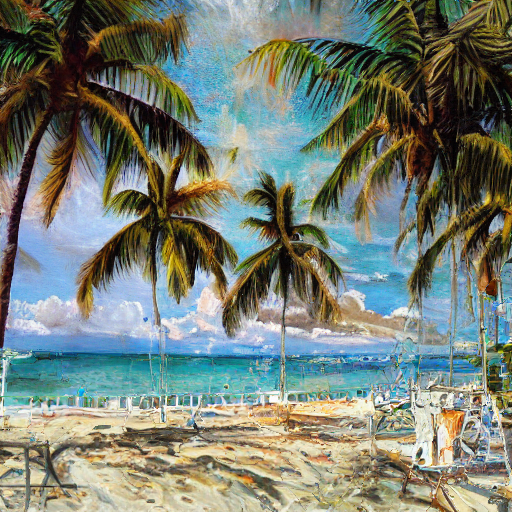

Saved processed image 15.png
Time passed: 273.91377902030945


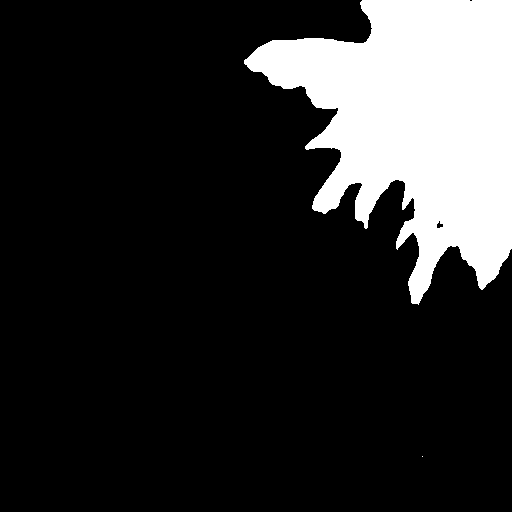

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of palm trees on the beach by william sidney mount trending on artstation.



  0%|          | 0/50 [00:00<?, ?it/s]

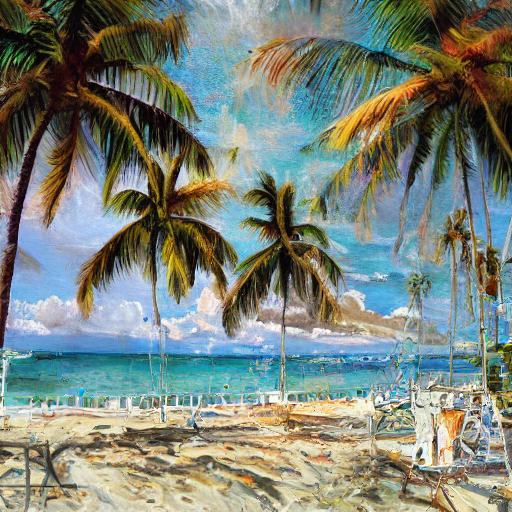

Saved processed image 16.png
Time passed: 292.7466449737549


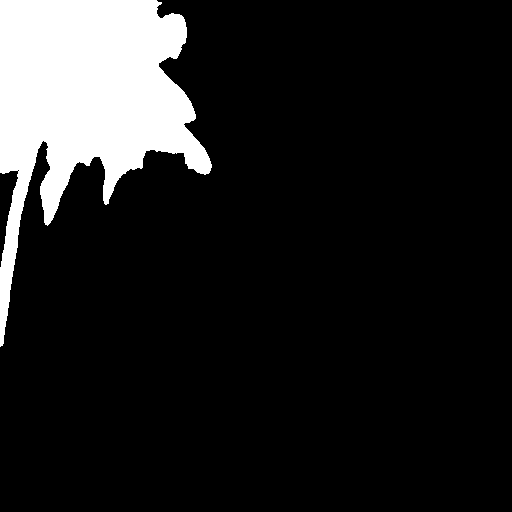

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of palm trees on the beach sunset


  0%|          | 0/50 [00:00<?, ?it/s]

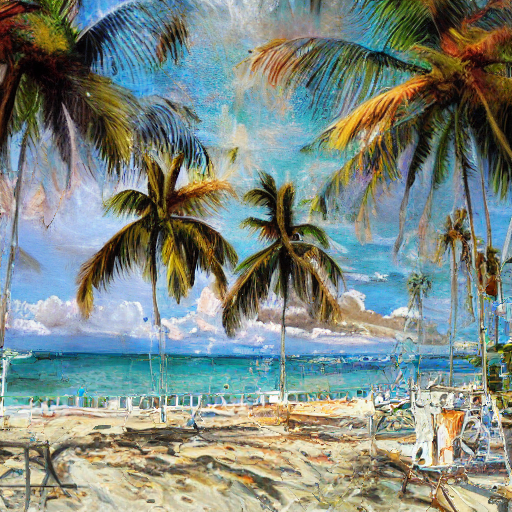

Saved processed image 17.png
Time passed: 311.8778965473175


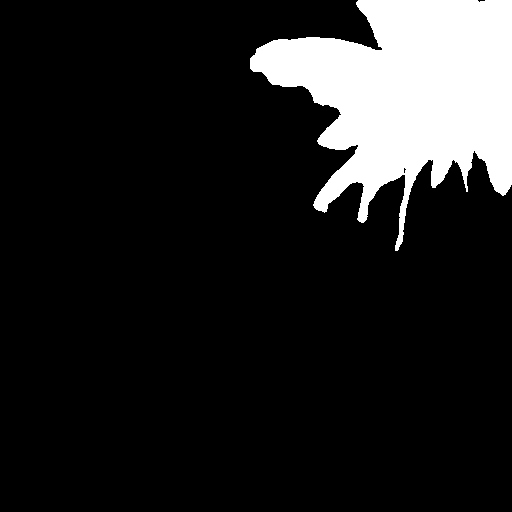

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of palm trees on the beach by ivan aivazovsky and greg rutkowski and james gurney and frank lloyd and sung choi and monet in style of impressionnisme


  0%|          | 0/50 [00:00<?, ?it/s]

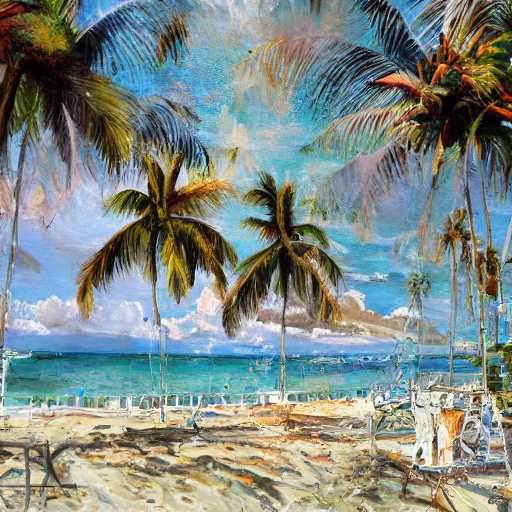

Saved processed image 18.png
Time passed: 330.9420256614685


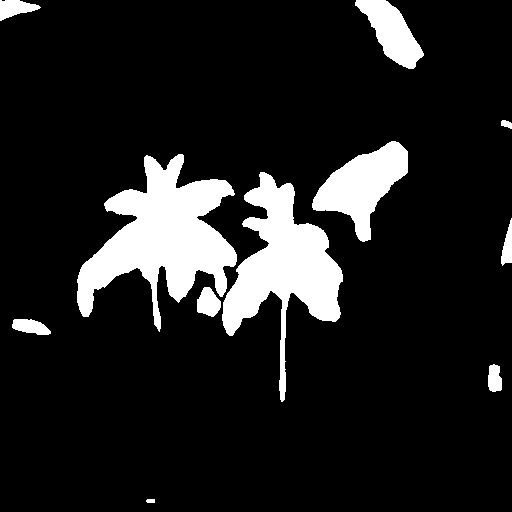

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of palm trees on the beach sunset!


  0%|          | 0/50 [00:00<?, ?it/s]

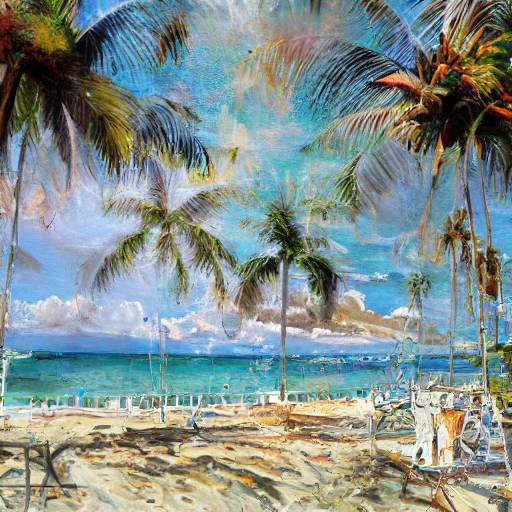

Saved processed image 19.png
Time passed: 349.9954516887665


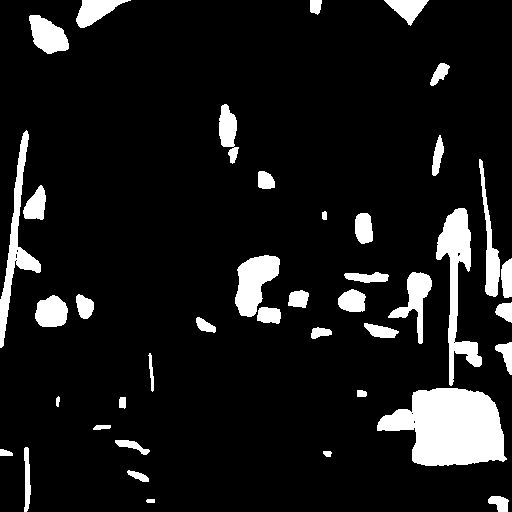

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of palm trees on the beach near a beach with a giant sea monster in the sky sunrise


  0%|          | 0/50 [00:00<?, ?it/s]

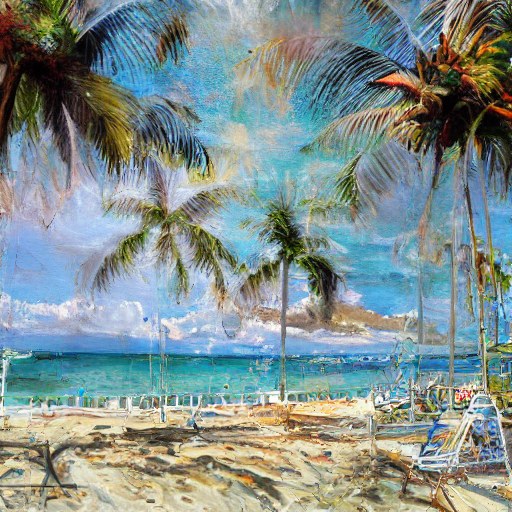

Saved processed image 20.png
Time passed: 369.6098916530609


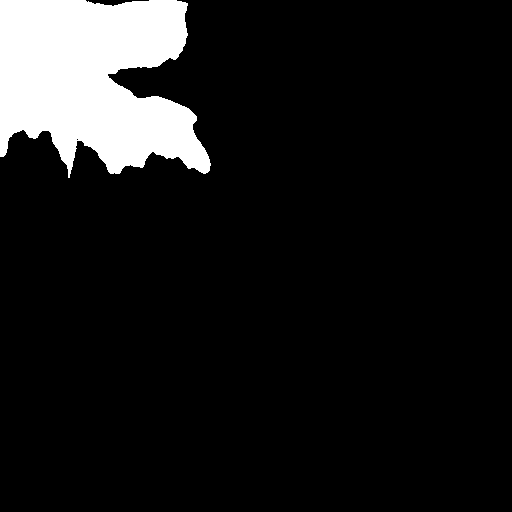

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of palm trees on the beach at sunset photorealistic


  0%|          | 0/50 [00:00<?, ?it/s]

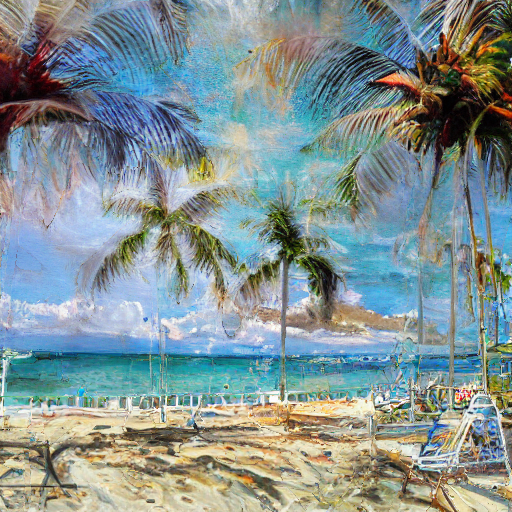

Saved processed image 21.png
Time passed: 388.650349855423


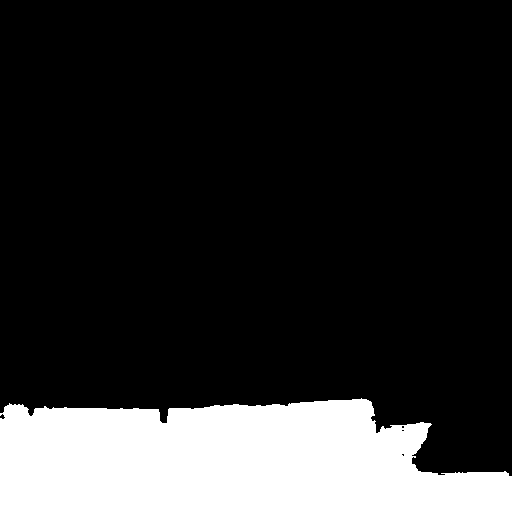

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of palm trees on the beach sunset


  0%|          | 0/50 [00:00<?, ?it/s]

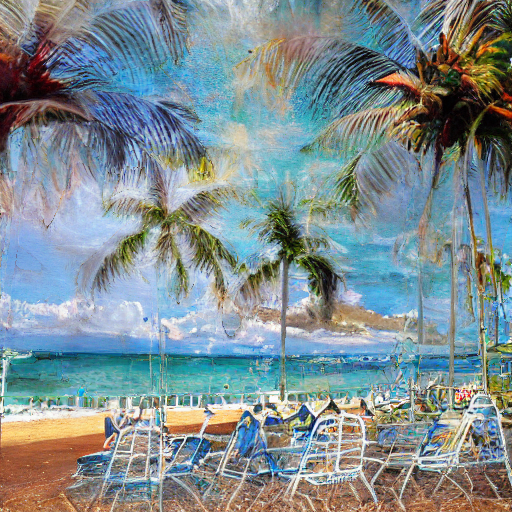

Saved processed image 22.png
Time passed: 408.0754499435425


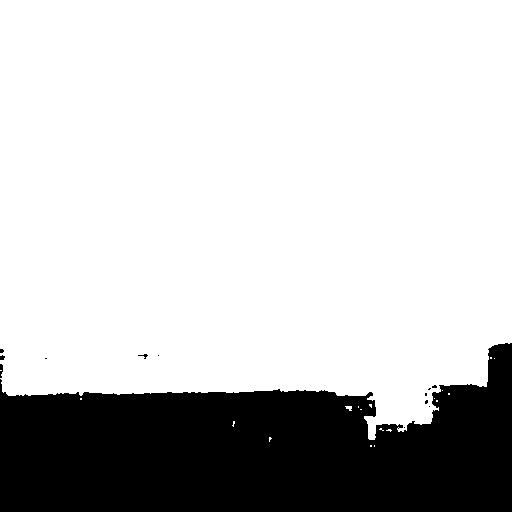

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background and colorful magic details :: by norman rockwell and boris vallejo artstation


  0%|          | 0/50 [00:00<?, ?it/s]

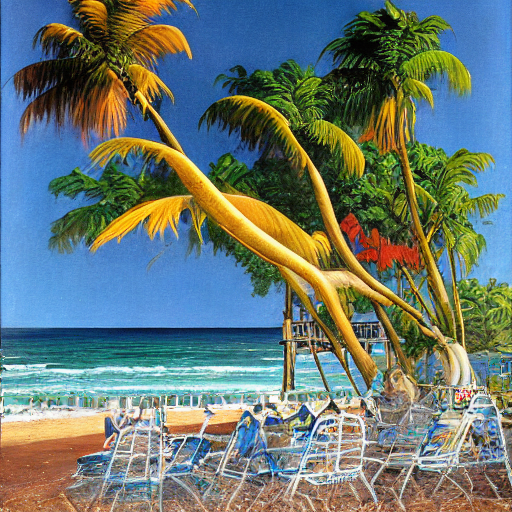

Saved processed image 23.png
Time passed: 427.6910684108734


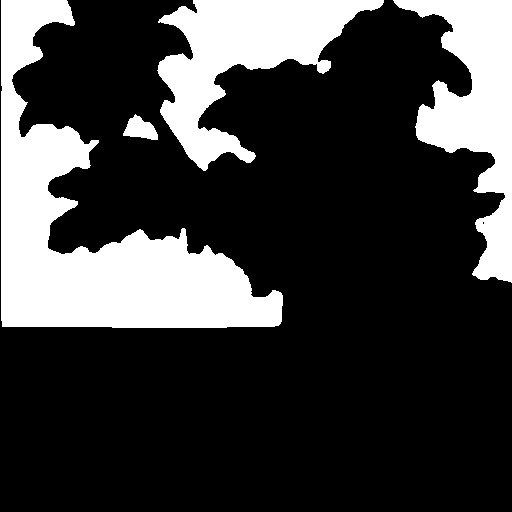

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background trending on Flickr by tooth wu and greg rutkowski



  0%|          | 0/50 [00:00<?, ?it/s]

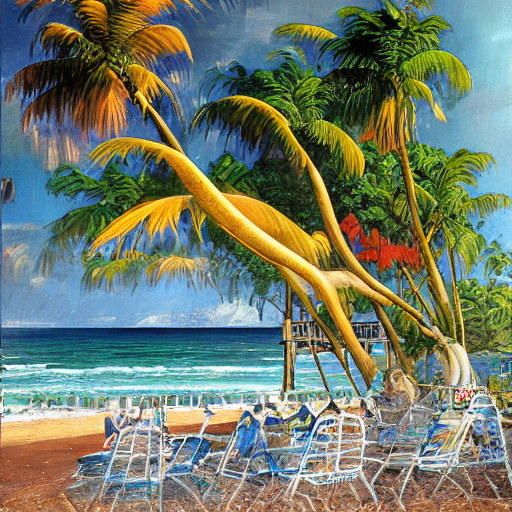

Saved processed image 24.png
Time passed: 447.50794982910156


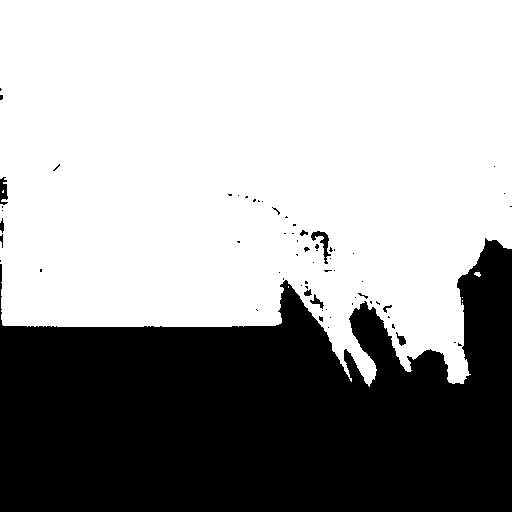

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background vibrant colors


  0%|          | 0/50 [00:00<?, ?it/s]

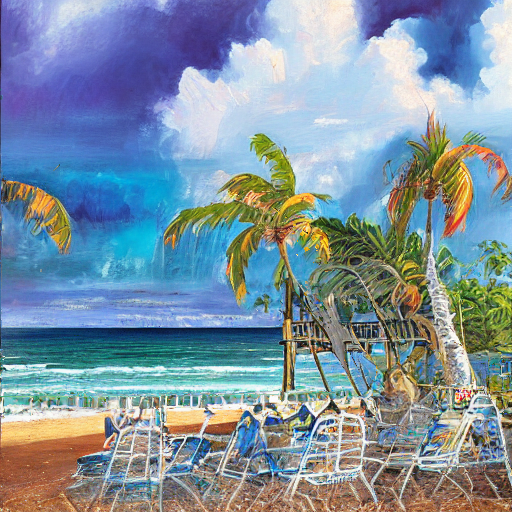

Saved processed image 25.png
Time passed: 467.49478673934937


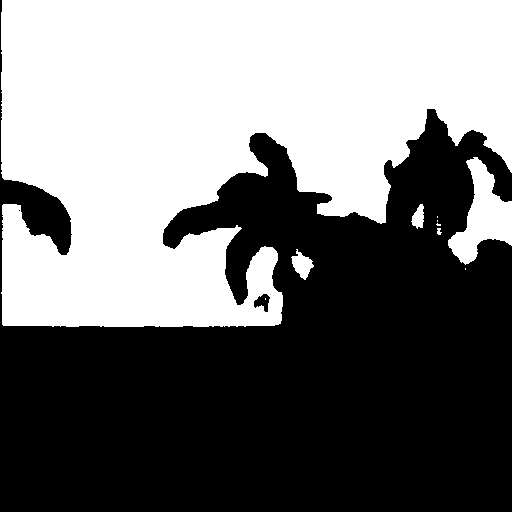

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with chairs and palm trees in the background trending on Artstation


  0%|          | 0/50 [00:00<?, ?it/s]

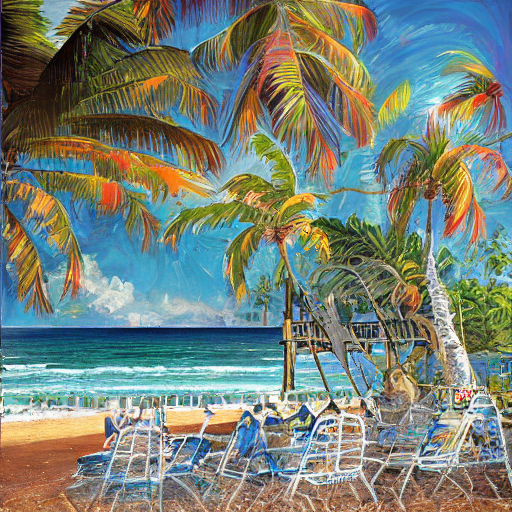

Saved processed image 26.png
Time passed: 487.8856518268585


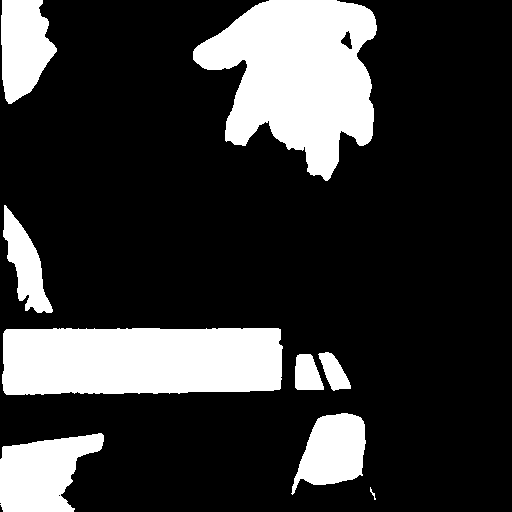

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background by rhads


  0%|          | 0/50 [00:00<?, ?it/s]

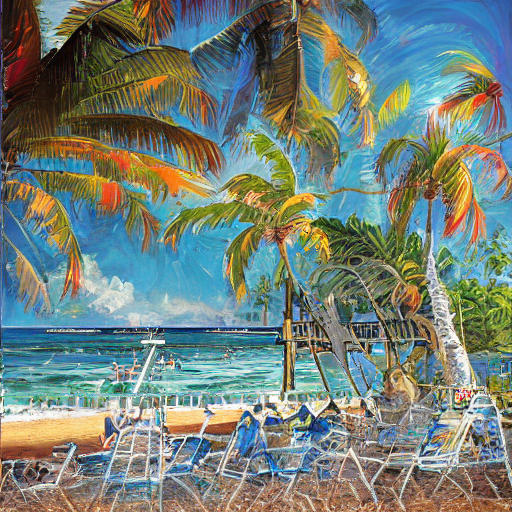

Saved processed image 27.png
Time passed: 507.54026103019714


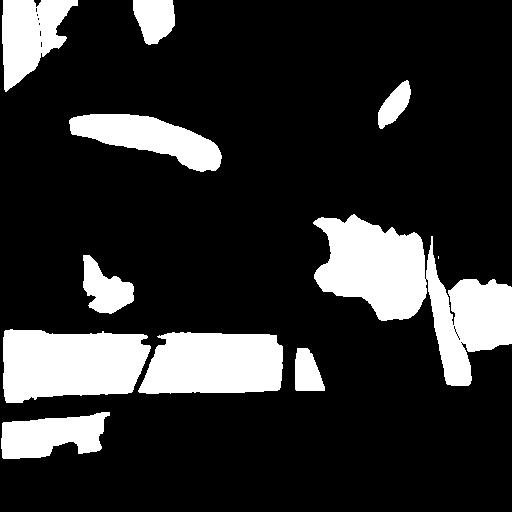

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with chairs and palm trees outside by Tim Okamura


  0%|          | 0/50 [00:00<?, ?it/s]

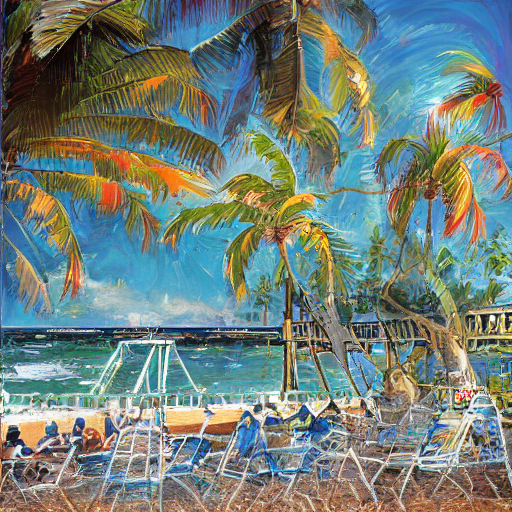

Saved processed image 28.png
Time passed: 527.7891592979431


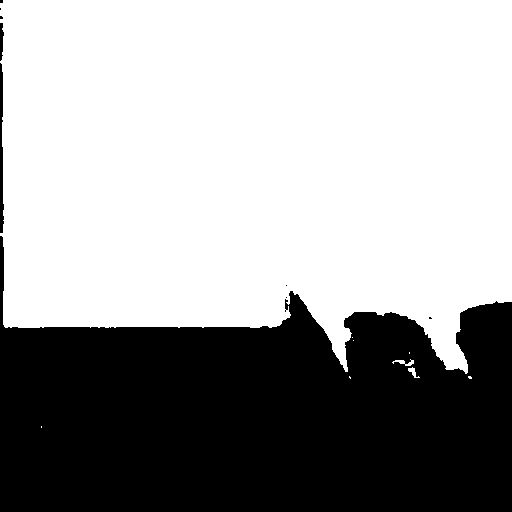

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background by Danar Worya


  0%|          | 0/50 [00:00<?, ?it/s]

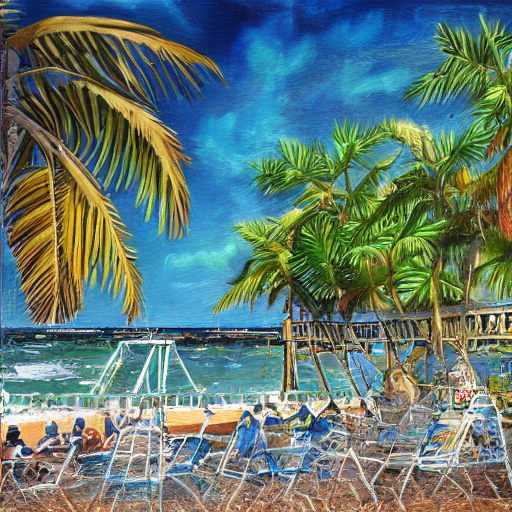

Saved processed image 29.png
Time passed: 547.1120023727417


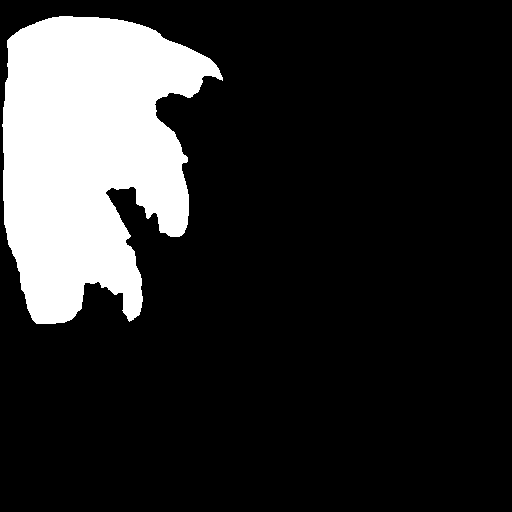

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees and chairs an ultrafine detailed painting by Asger Jorn


  0%|          | 0/50 [00:00<?, ?it/s]

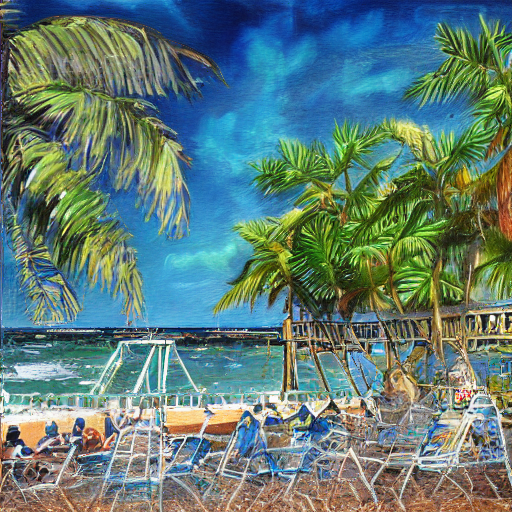

Saved processed image 30.png
Time passed: 567.8243100643158


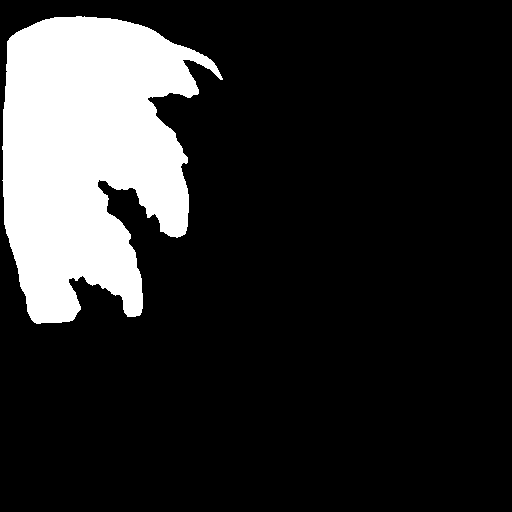

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees and chairs by Tim Okamura


  0%|          | 0/50 [00:00<?, ?it/s]

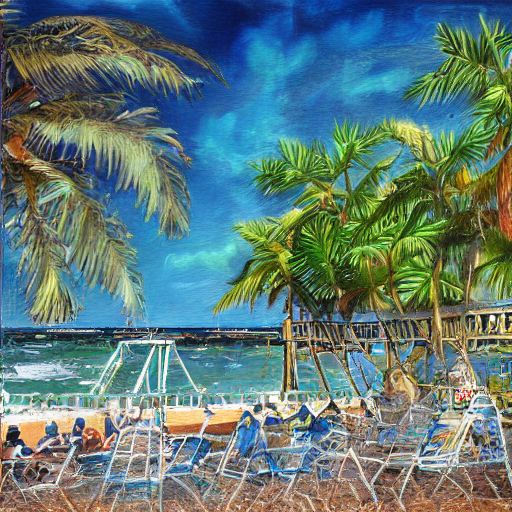

Saved processed image 31.png
Time passed: 588.3985500335693


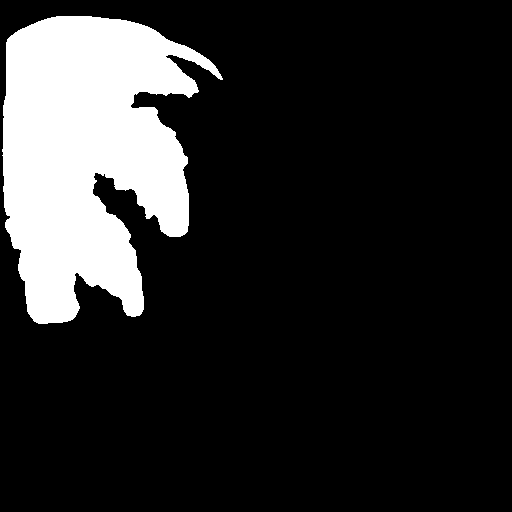

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees and chairs an oil painting by rafal olbinski


  0%|          | 0/50 [00:00<?, ?it/s]

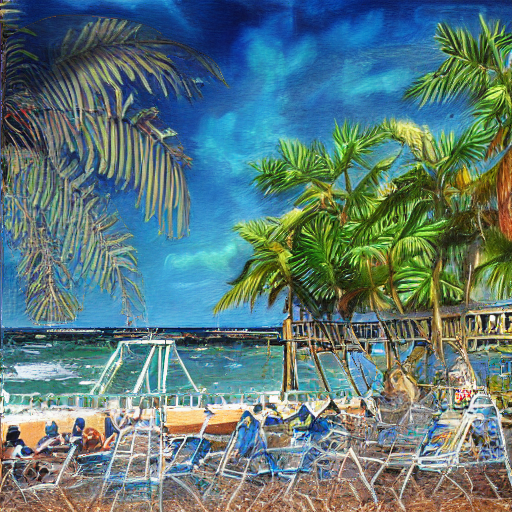

Saved processed image 32.png
Time passed: 608.9039890766144


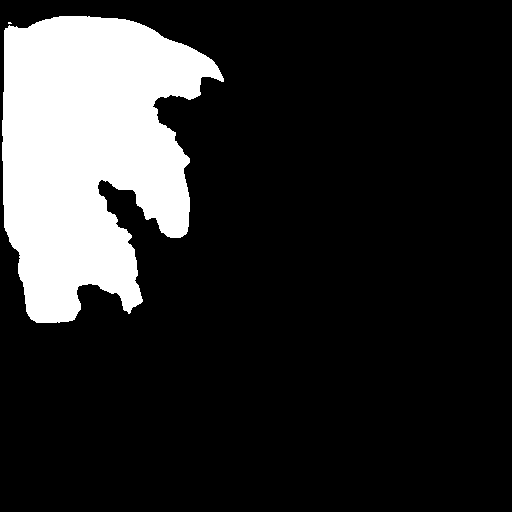

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees and chairs high contrast


  0%|          | 0/50 [00:00<?, ?it/s]

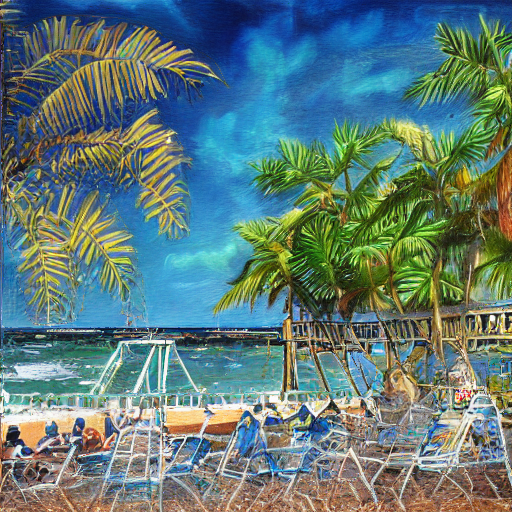

Saved processed image 33.png
Time passed: 628.8492228984833


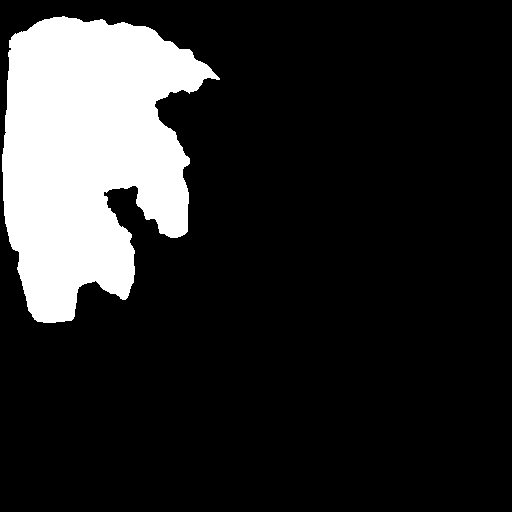

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees and chairs corporate office attire


  0%|          | 0/50 [00:00<?, ?it/s]

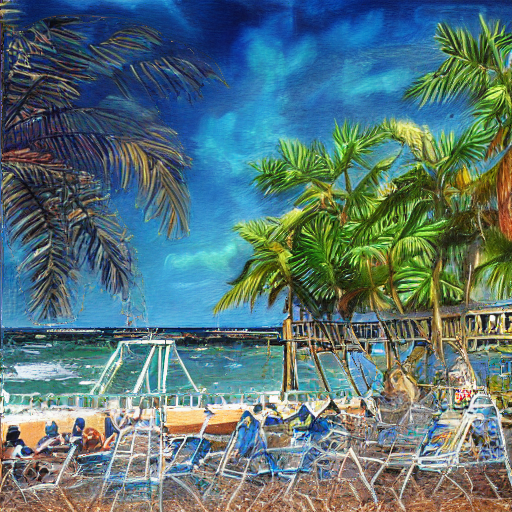

Saved processed image 34.png
Time passed: 649.195565700531


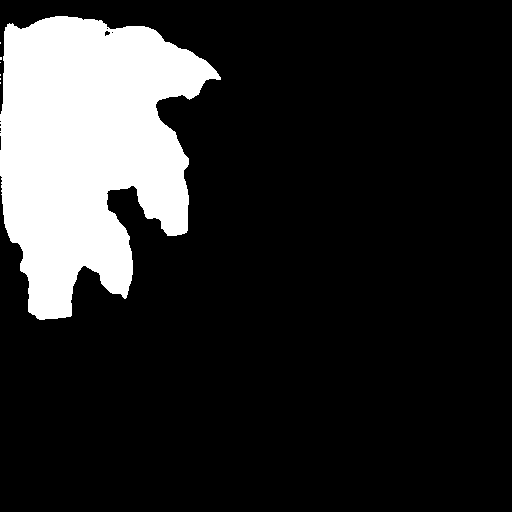

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees and chairs at sunset Pixar style


  0%|          | 0/50 [00:00<?, ?it/s]

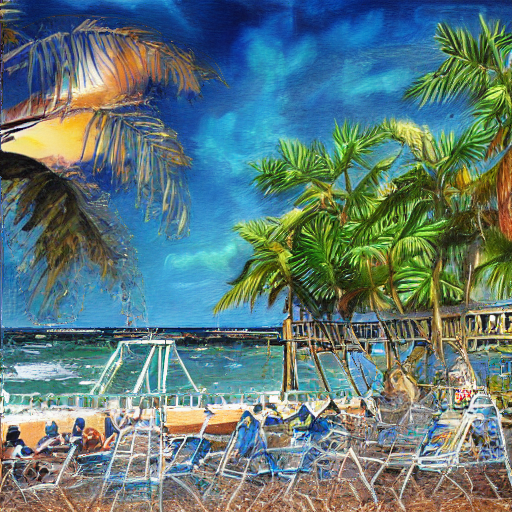

Saved processed image 35.png
Time passed: 669.0237720012665


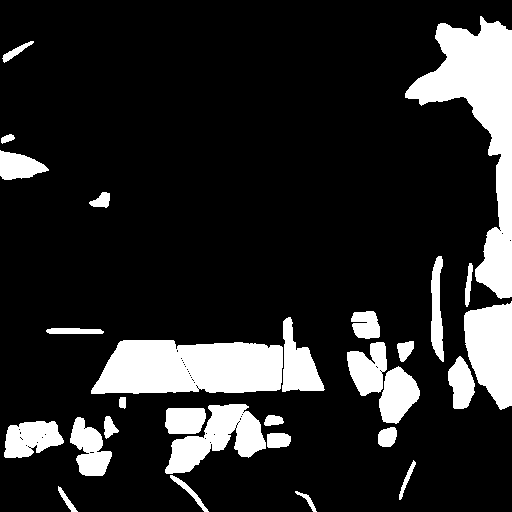

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees and chairs golden hour


  0%|          | 0/50 [00:00<?, ?it/s]

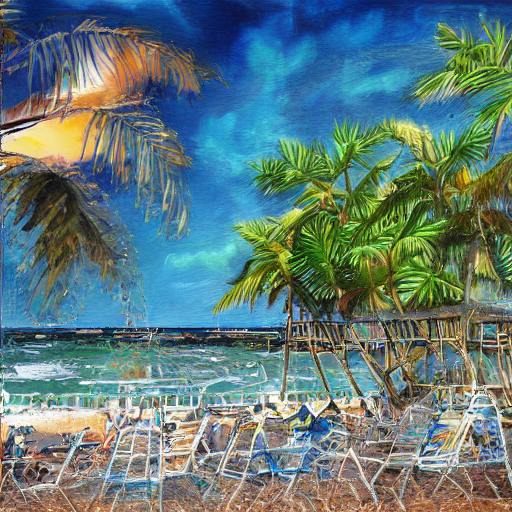

Saved processed image 36.png
Time passed: 688.6209082603455


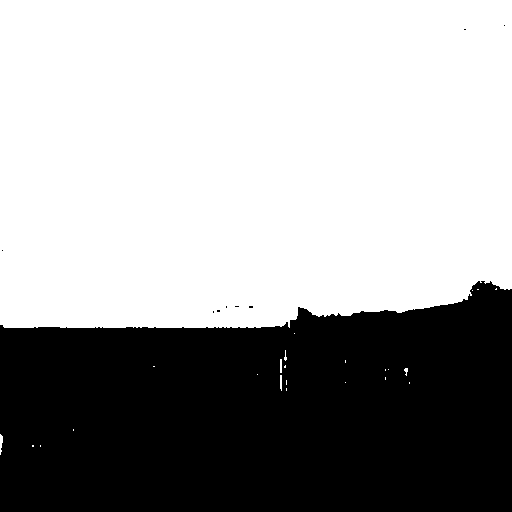

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with chairs and palm trees volleyball court


  0%|          | 0/50 [00:00<?, ?it/s]

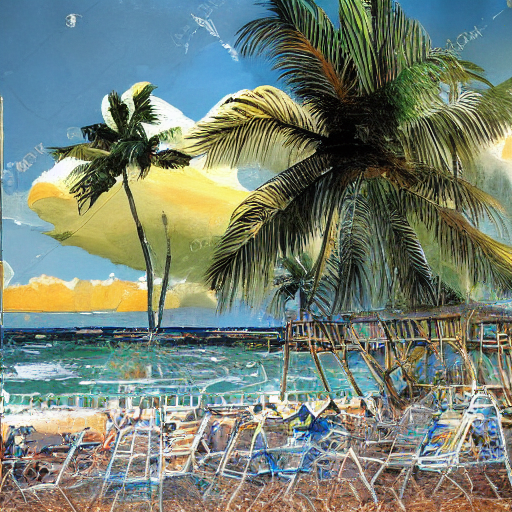

Saved processed image 37.png
Time passed: 708.6030268669128


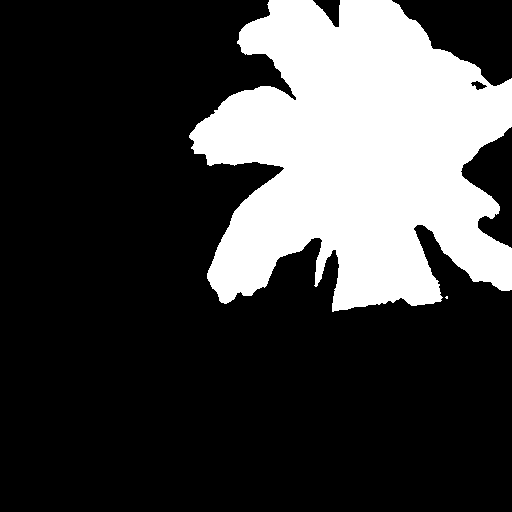

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees and chairs a detailed matte painting by stephan martiniere


  0%|          | 0/50 [00:00<?, ?it/s]

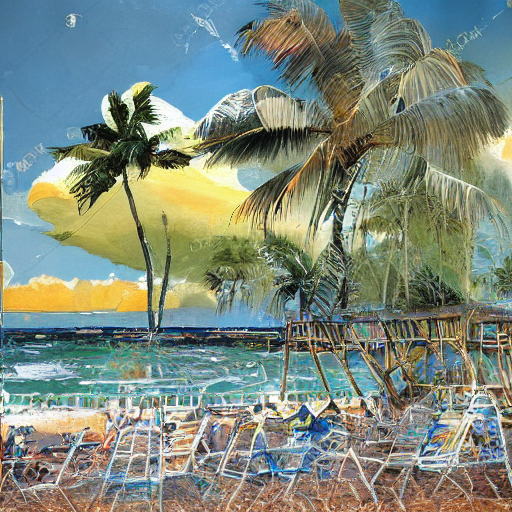

Saved processed image 38.png
Time passed: 728.7311706542969


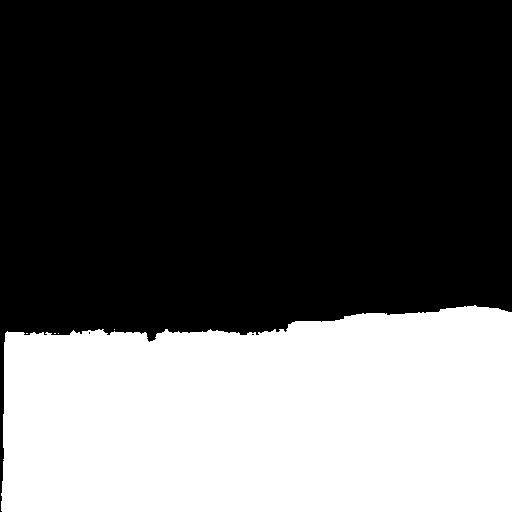

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees and chairs a detailed matte painting by Mark Keathley


  0%|          | 0/50 [00:00<?, ?it/s]

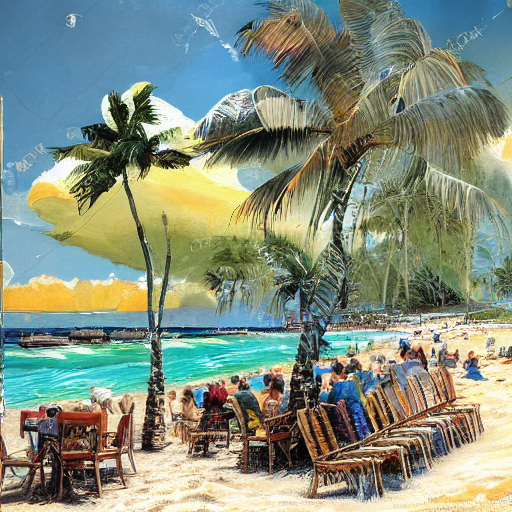

Saved processed image 39.png
Time passed: 748.7409479618073


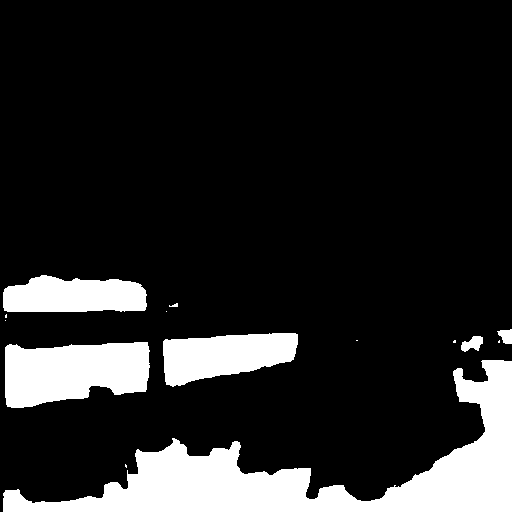

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees and people walking by a beach at sunset | | cute - fine - face pretty face


  0%|          | 0/50 [00:00<?, ?it/s]

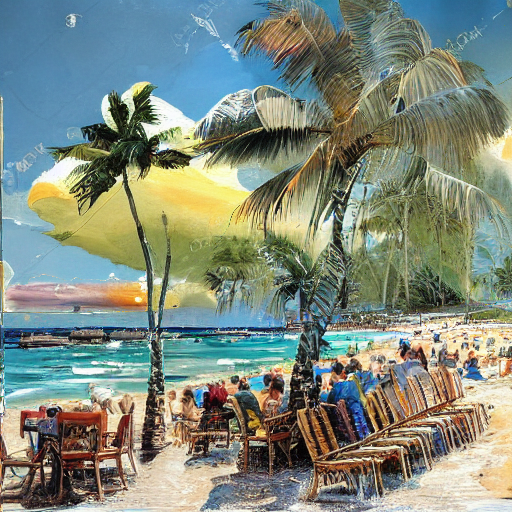

Saved processed image 40.png
Time passed: 769.0406978130341


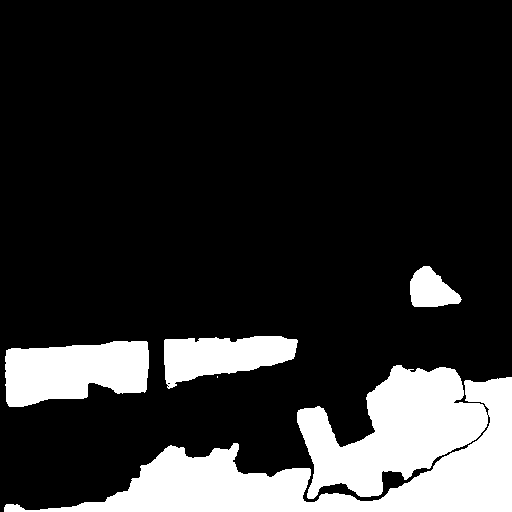

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees and people walking together by rhads


  0%|          | 0/50 [00:00<?, ?it/s]

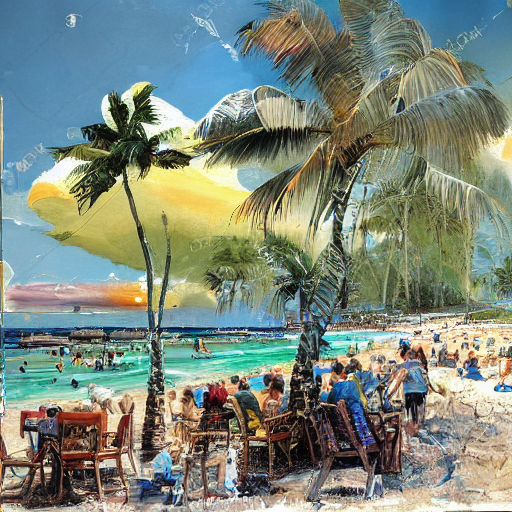

Saved processed image 41.png
Time passed: 788.8633699417114


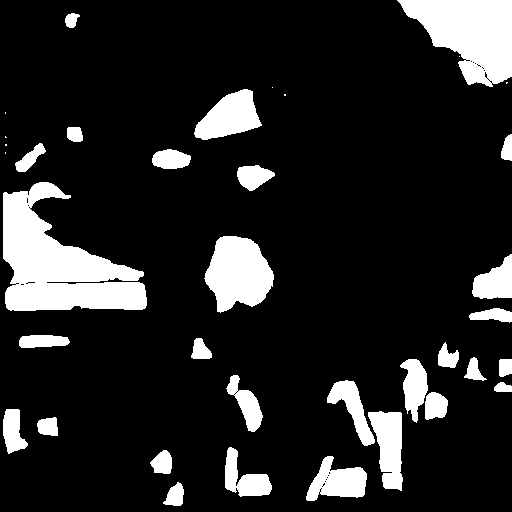

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of people on the beach sunset


  0%|          | 0/50 [00:00<?, ?it/s]

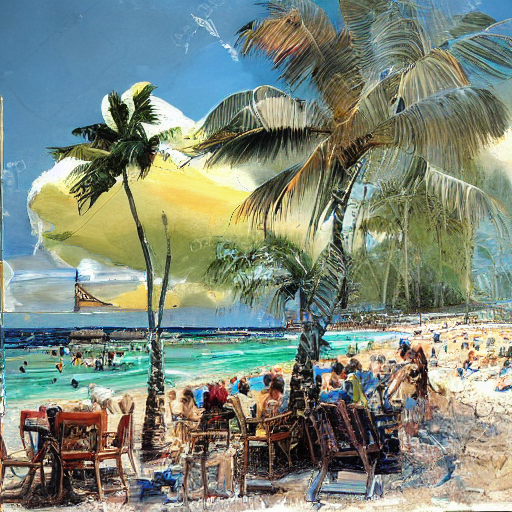

Saved processed image 42.png
Time passed: 807.7205266952515


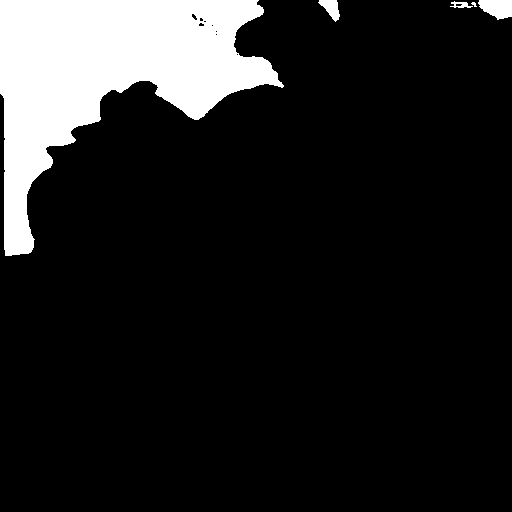

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background by Jama Jurabaev extremely detailed


  0%|          | 0/50 [00:00<?, ?it/s]

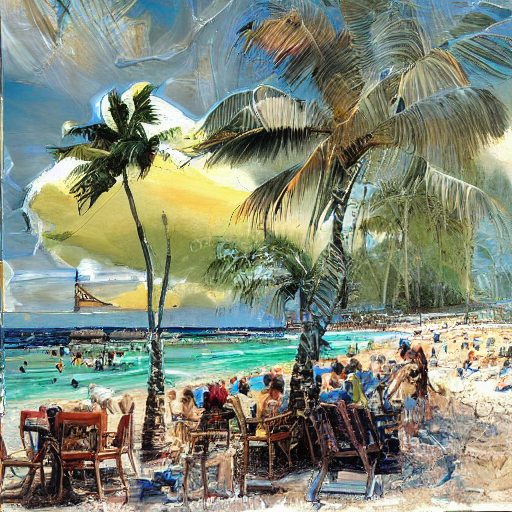

Saved processed image 43.png
Time passed: 827.3085992336273


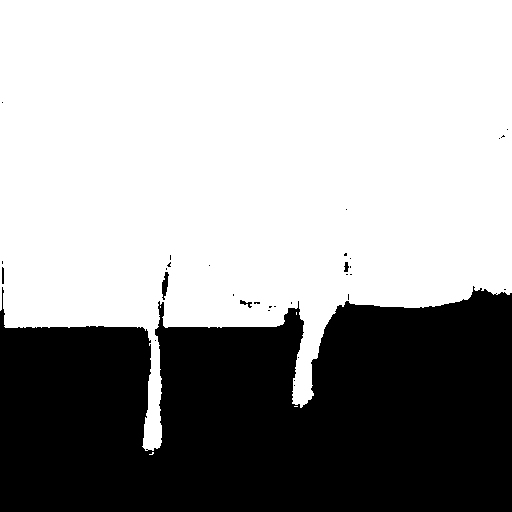

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees and golden rays of light shining through raytracing


  0%|          | 0/50 [00:00<?, ?it/s]

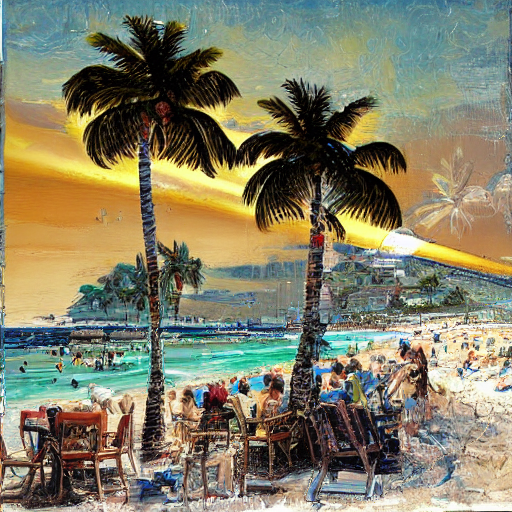

Saved processed image 44.png
Time passed: 846.7681798934937


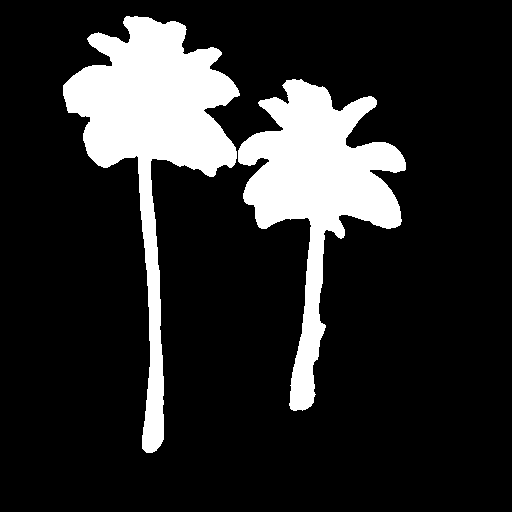

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees and blue ocean trending on artstation in the style of greg rutkowski



  0%|          | 0/50 [00:00<?, ?it/s]

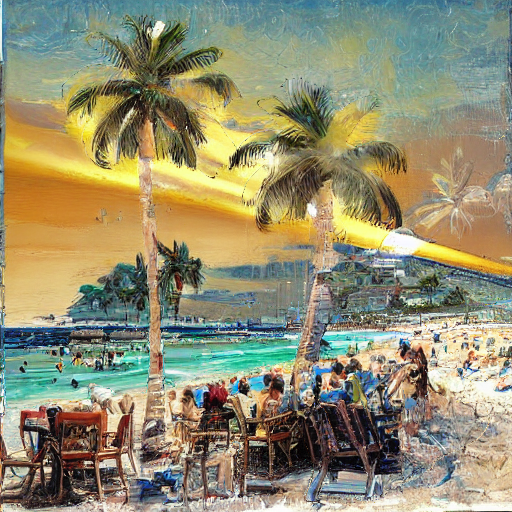

Saved processed image 45.png
Time passed: 866.578852891922


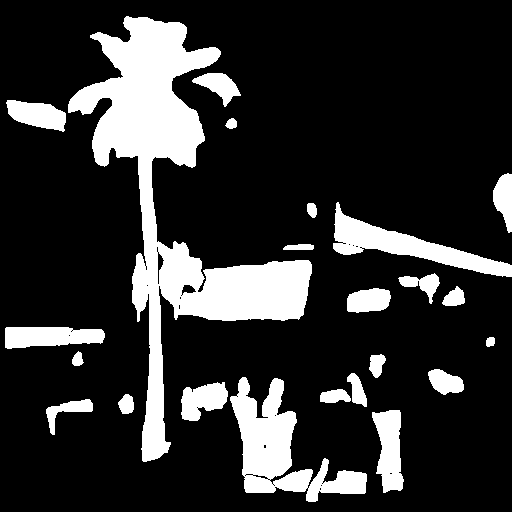

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background vibrant colors


  0%|          | 0/50 [00:00<?, ?it/s]

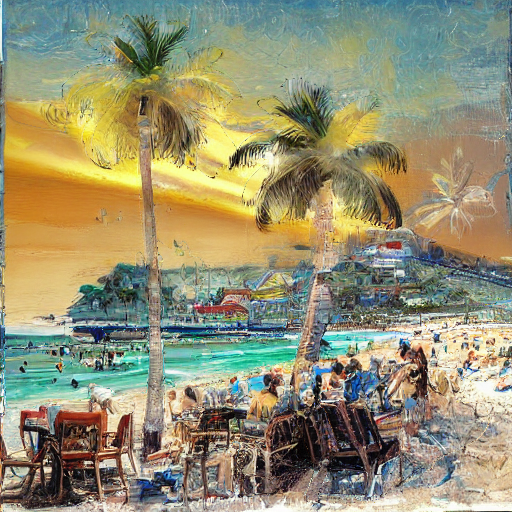

Saved processed image 46.png
Time passed: 885.8249657154083


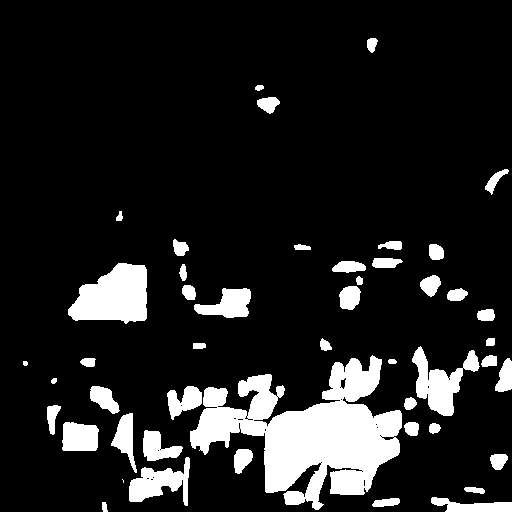

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background Pixar Disney 4K 3d render funny animation movie Oscar winning trending on ArtStation and Behance


  0%|          | 0/50 [00:00<?, ?it/s]

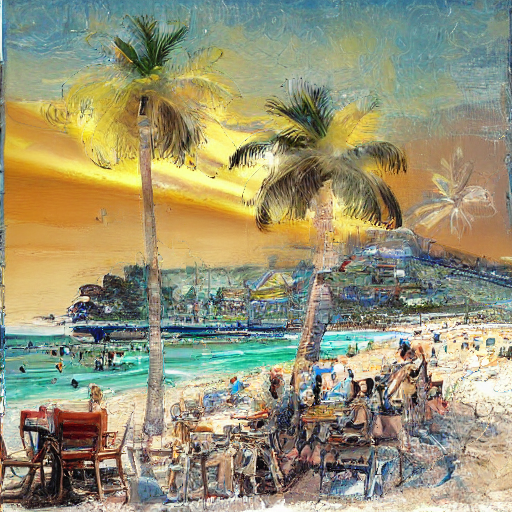

Saved processed image 47.png
Time passed: 905.4432144165039


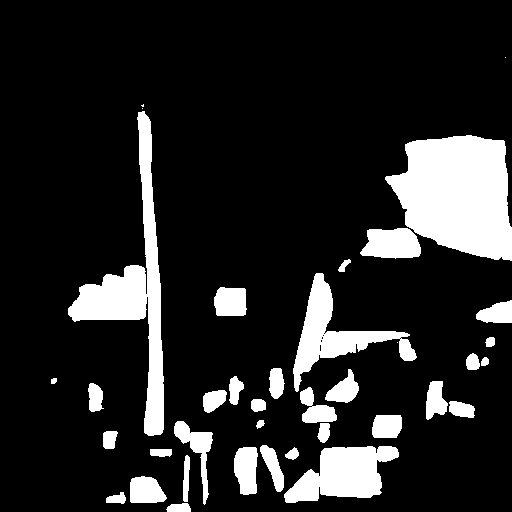

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background and corporate logos behind by bill sienkiewicz and adam vargas and james gurney trending on artstation


  0%|          | 0/50 [00:00<?, ?it/s]

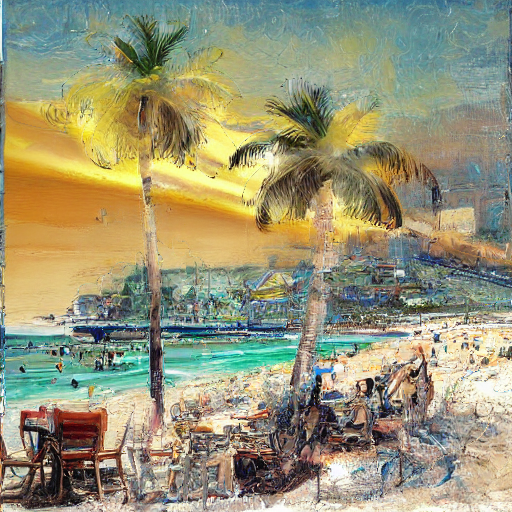

Saved processed image 48.png
Time passed: 924.5952115058899


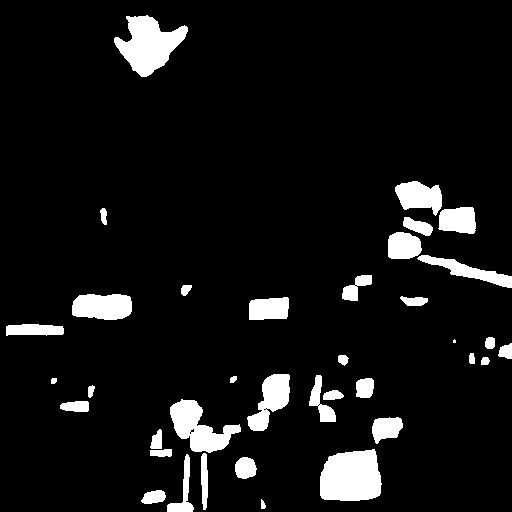

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background studio Ghibli


  0%|          | 0/50 [00:00<?, ?it/s]

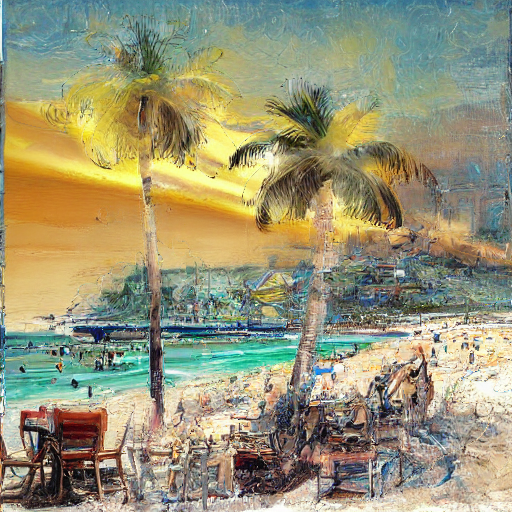

Saved processed image 49.png
Time passed: 943.8130600452423


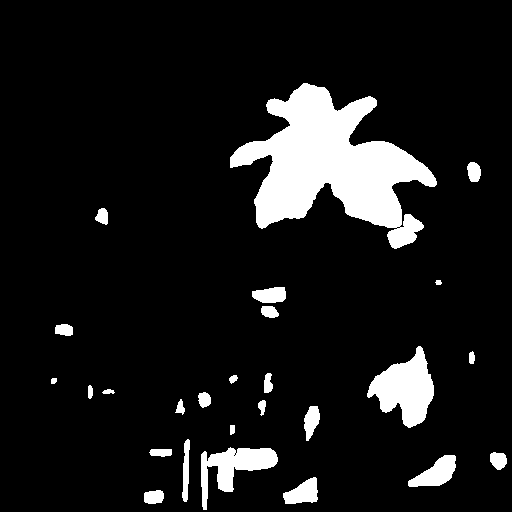

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background art by Noah Bradley


  0%|          | 0/50 [00:00<?, ?it/s]

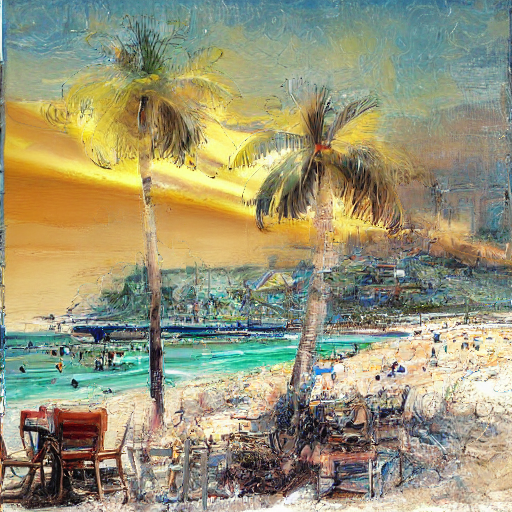

Saved processed image 50.png
Time passed: 962.9786763191223


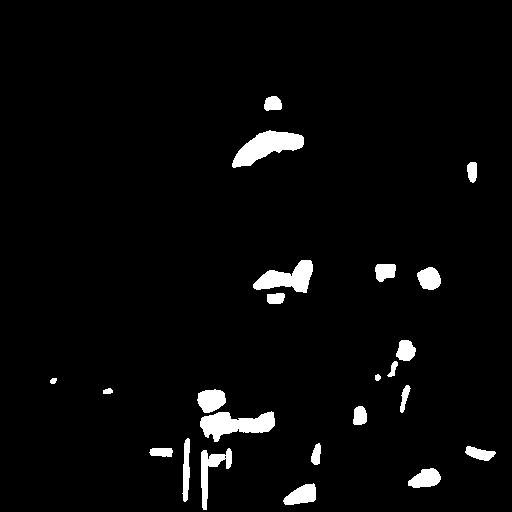

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background art by Rebecca Guay and Greg Rutkowski


  0%|          | 0/50 [00:00<?, ?it/s]

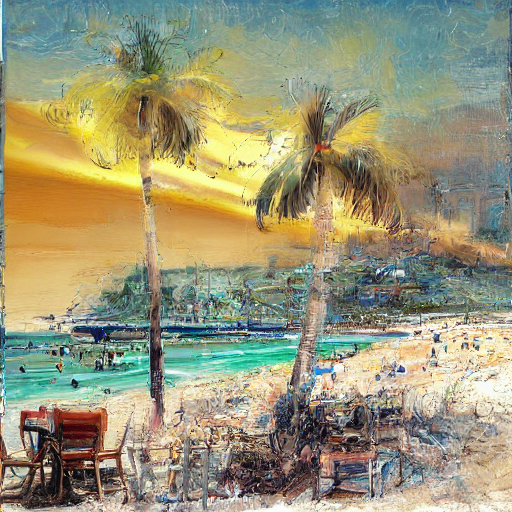

Saved processed image 51.png
Time passed: 982.5130009651184


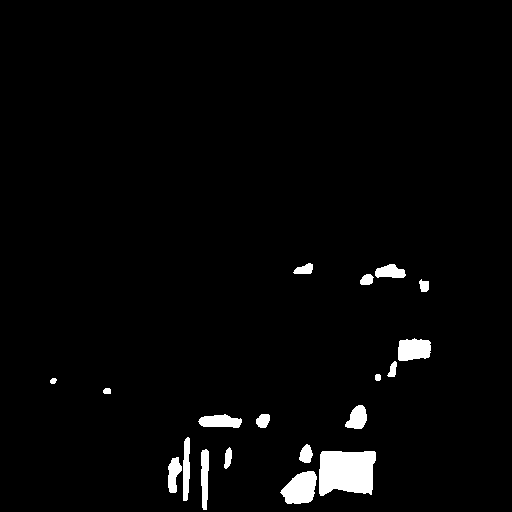

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background science fiction painting by norman rockwell and greg rutkowski


  0%|          | 0/50 [00:00<?, ?it/s]

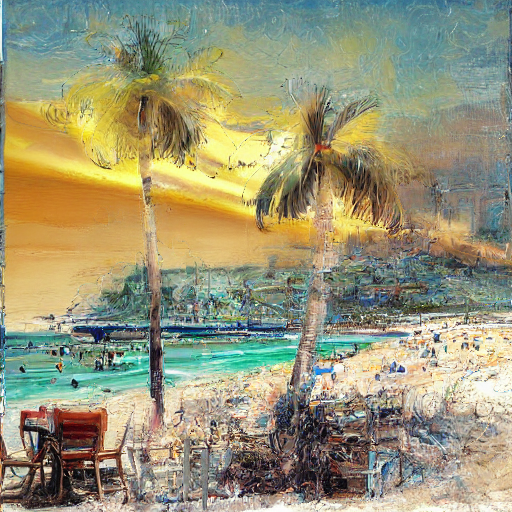

Saved processed image 52.png
Time passed: 1002.1911528110504


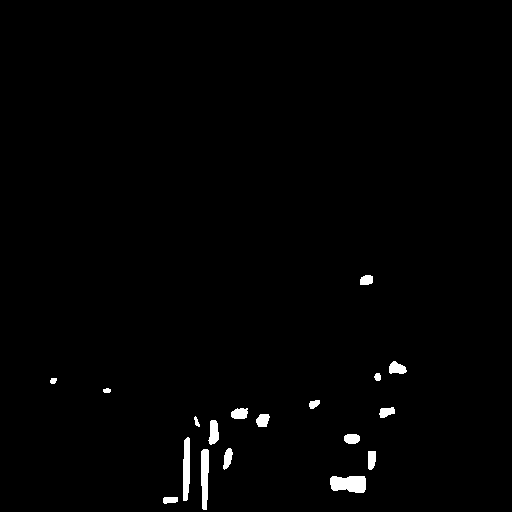

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background by artgerm


  0%|          | 0/50 [00:00<?, ?it/s]

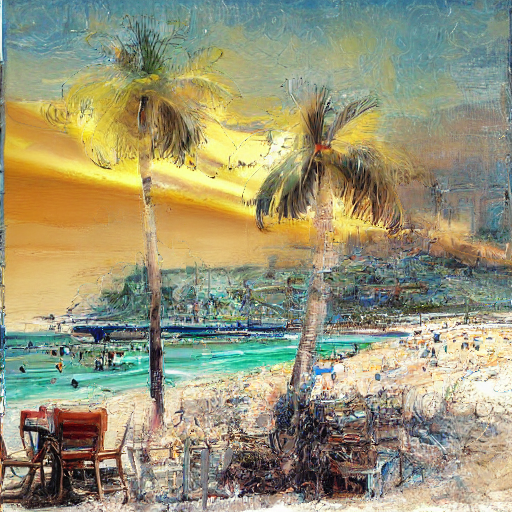

Saved processed image 53.png
Time passed: 1021.522166967392


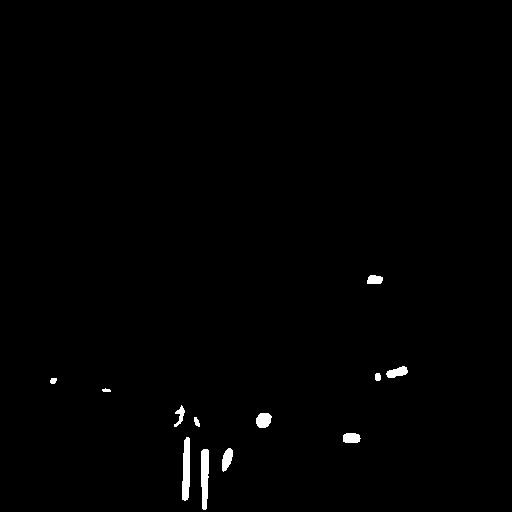

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background art by Rebecca Guay and Margaux Portman


  0%|          | 0/50 [00:00<?, ?it/s]

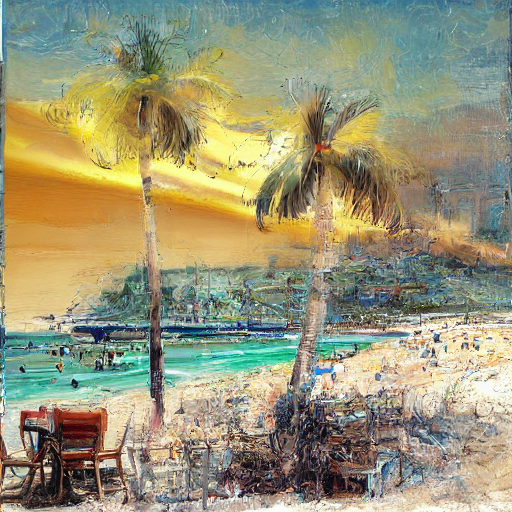

Saved processed image 54.png
Time passed: 1040.6543972492218


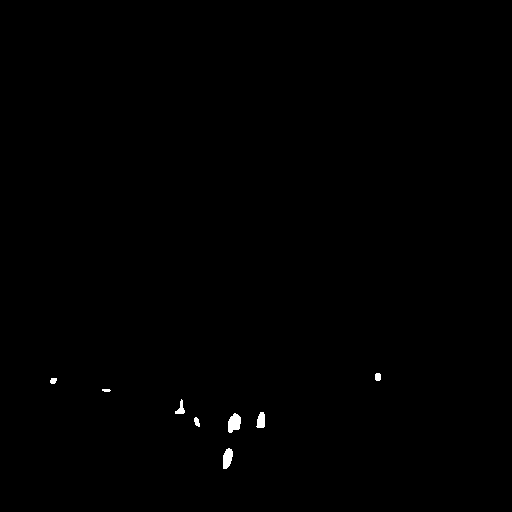

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background atmospheric


  0%|          | 0/50 [00:00<?, ?it/s]

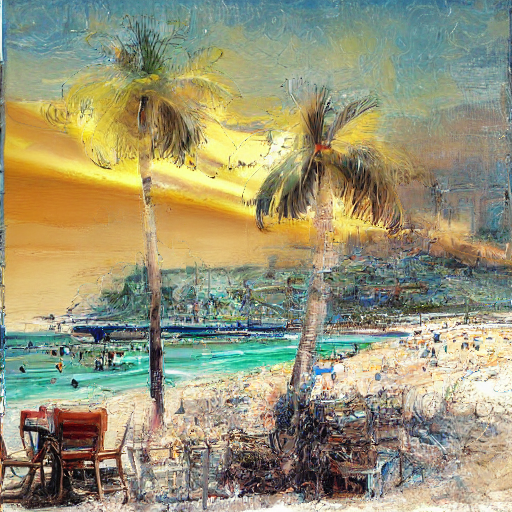

Saved processed image 55.png
Time passed: 1059.9907538890839


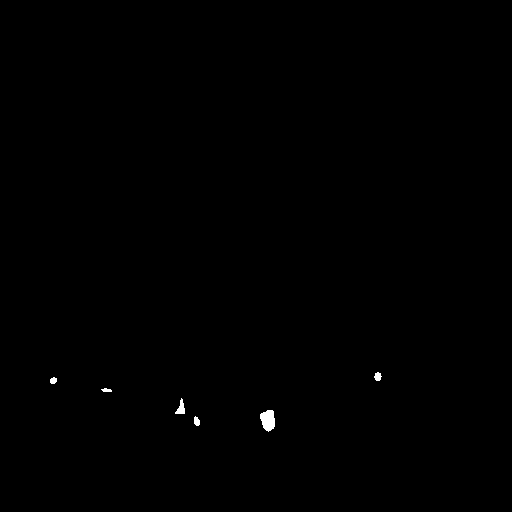

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background by René Burri behance contest winner


  0%|          | 0/50 [00:00<?, ?it/s]

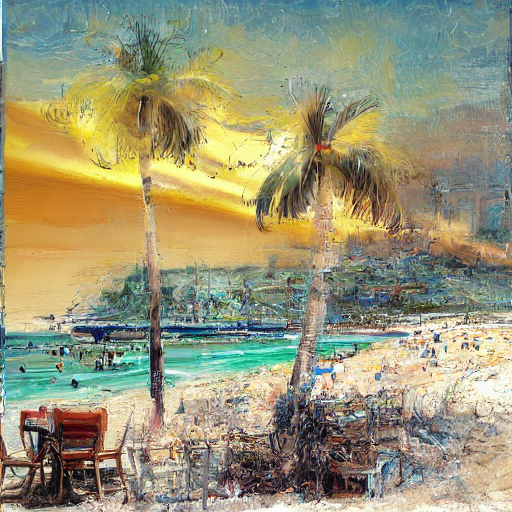

Saved processed image 56.png
Time passed: 1079.075758934021


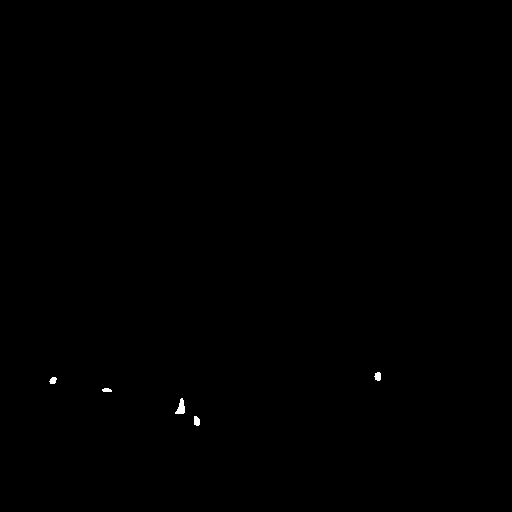

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background the beach has a wooden pier and sand in the background


  0%|          | 0/50 [00:00<?, ?it/s]

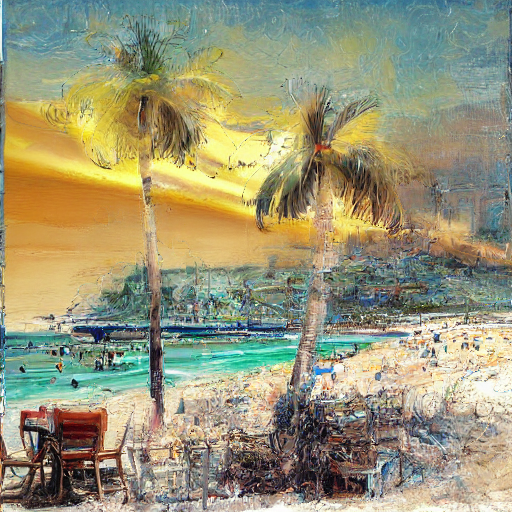

Saved processed image 57.png
Time passed: 1098.6185355186462


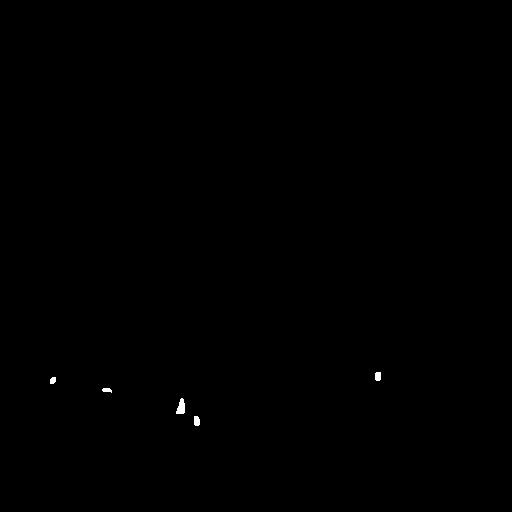

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the shore full body


  0%|          | 0/50 [00:00<?, ?it/s]

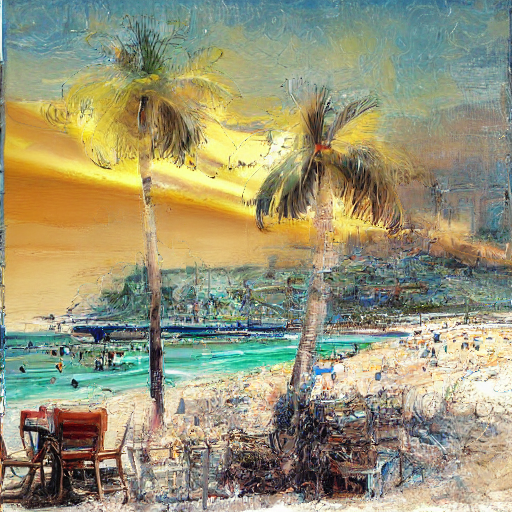

Saved processed image 58.png
Time passed: 1118.420386314392


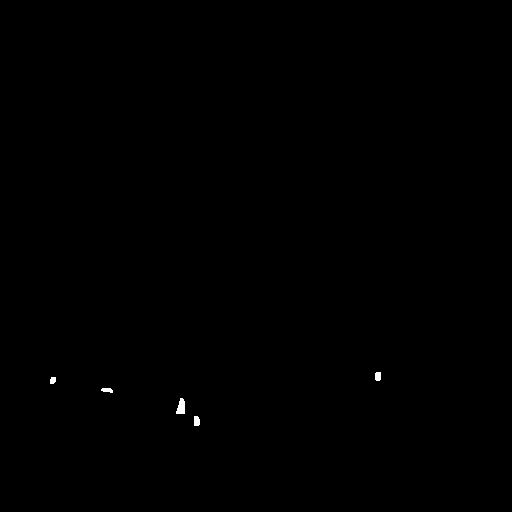

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background by Raoul Vitale and Alphonse Mucha


  0%|          | 0/50 [00:00<?, ?it/s]

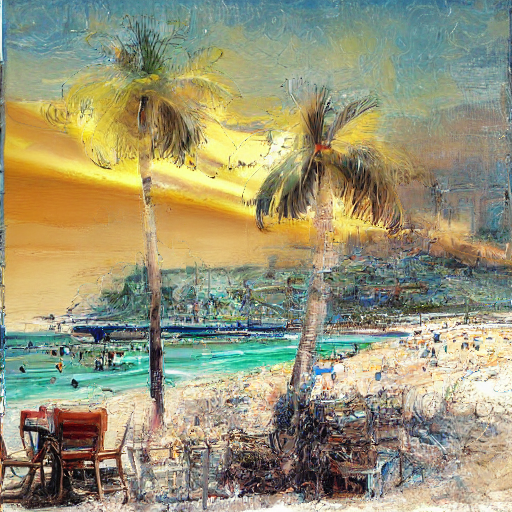

Saved processed image 59.png
Time passed: 1137.9201016426086


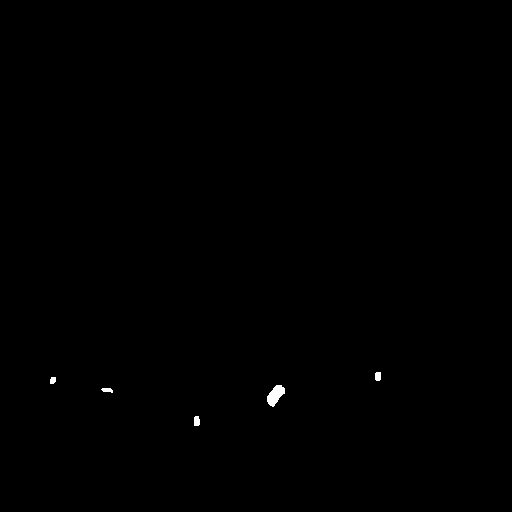

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background | bandai box office hitman movie poster lit | year's eve movie poster


  0%|          | 0/50 [00:00<?, ?it/s]

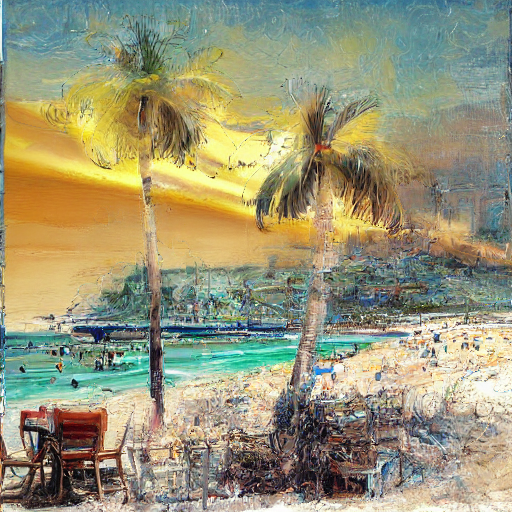

Saved processed image 60.png
Time passed: 1157.4321887493134


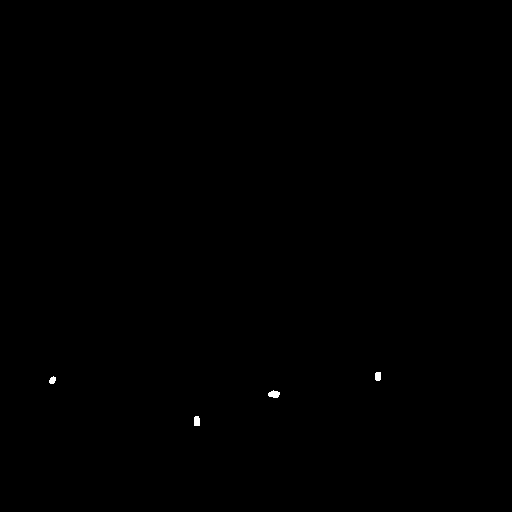

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees in the background science fiction concept art by jim burns and greg rutkowski


  0%|          | 0/50 [00:00<?, ?it/s]

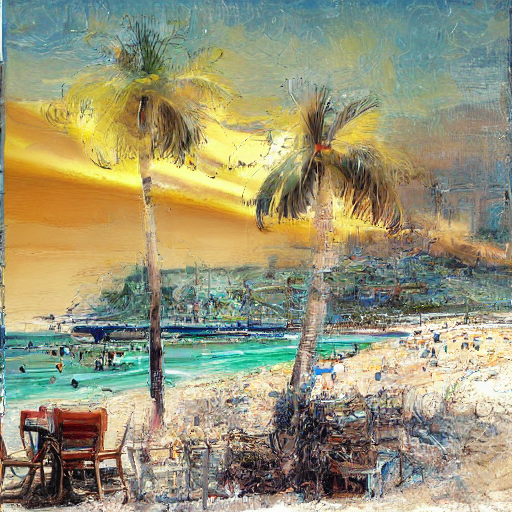

Saved processed image 61.png
Time passed: 1176.635579109192


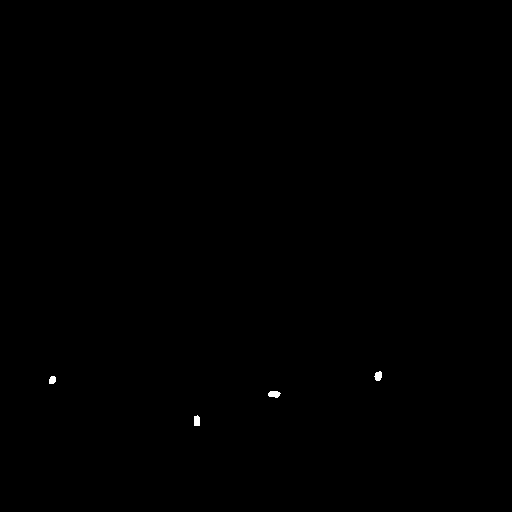

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees and sand by James Gilleard


  0%|          | 0/50 [00:00<?, ?it/s]

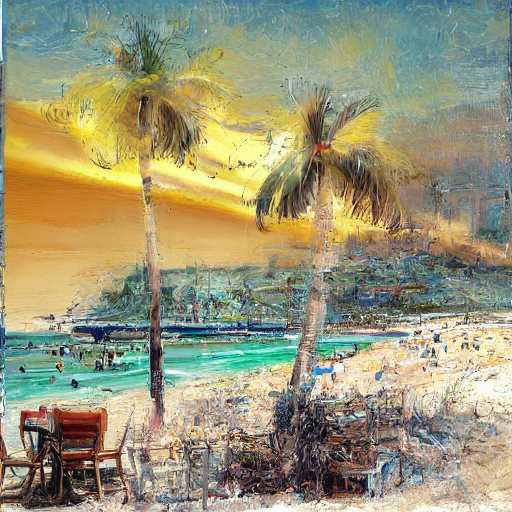

Saved processed image 62.png
Time passed: 1196.0664536952972


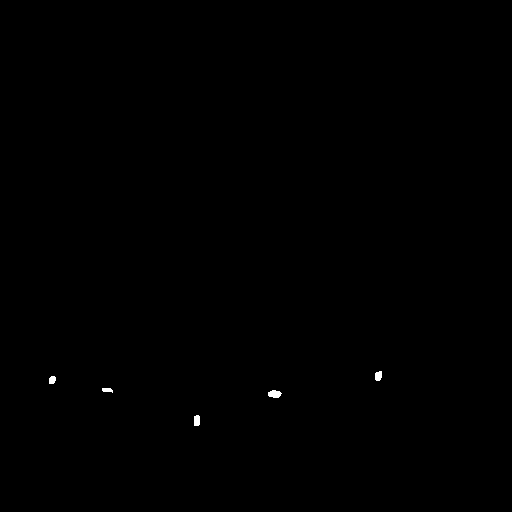

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees on the horizon and waves splashing by Remedios Varo and Anato Finnstark and Greg Rutkowski


  0%|          | 0/50 [00:00<?, ?it/s]

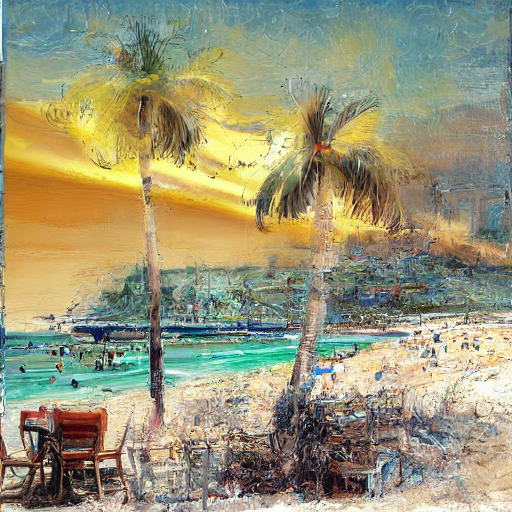

Saved processed image 63.png
Time passed: 1215.841432094574


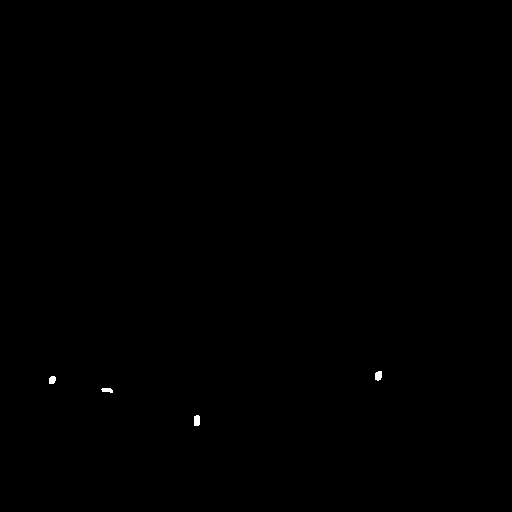

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


a painting of a beach scene with palm trees at sunrise studio ghibli


  0%|          | 0/50 [00:00<?, ?it/s]

Buffered data was truncated after reaching the output size limit.

In [ ]:
import requests

start_time = time.time()

path = "drive/MyDrive/Creative_Test5"


#img_url = "https://cdn.i-scmp.com/sites/default/files/d8/images/methode/2020/12/25/082b5d7a-440f-11eb-be92-09cd005df0bf_image_hires_235916.jpg"  # Trump
#img_url = "https://evermotion.org/files/publications_images/0002_RGB_big_thumb.jpg"  # City
#img_url = "https://assets1.ignimgs.com/2017/11/06/starwarsshipscenes-2-yt-1510004191258_160w.jpg?width=1280"  # Star Wars
#img_url = "https://wallpaperaccess.com/full/2117775.jpg"  # mountains
img_url = "https://cdn.wallpapersafari.com/94/57/FiWP4u.jpg"  # beach
image = Image.open(requests.get(img_url, stream=True).raw).convert("RGB").resize((512,512))
image.save(path + "/0.png")
image.show()

for id in range(1, 80):
  image = generate_datapoint_single_mask(image, id, path)
  print(f"Time passed: {time.time() - start_time}")



In [ ]:
from PIL import Image
import glob

# Create the frames
frames = []
imgs = glob.glob("drive/MyDrive/Creative_Test5/*.png")
for i in imgs:
    new_frame = Image.open(i)
    frames.append(new_frame)

# Save into a GIF file that loops forever
frames[0].save('png_to_gif4.gif', format='GIF',
               append_images=frames[1:],
               save_all=True,
               duration=300, loop=0)